
# Medical-Image-Processing__Morphology-DenoisingMethods-NLM-TotalVariation
## [Arya Koureshi](aryakoureshi.github.io)
## arya.koureshi@gmail.com
---

# Theory section

## Question 1

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

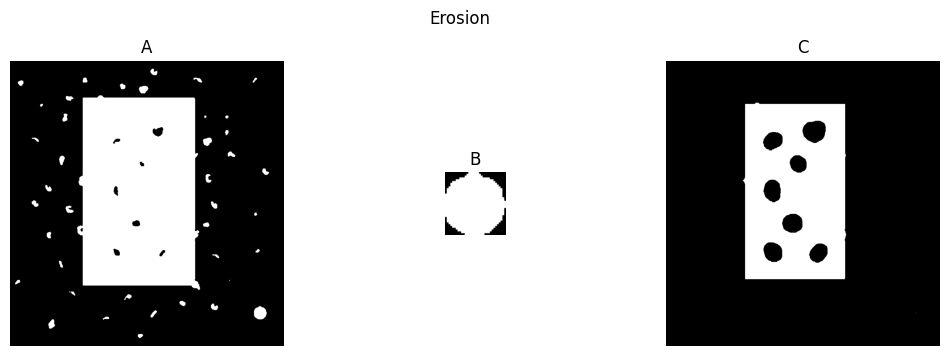

In [2]:
# %% part a
A = cv2.imread('C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/Theorem/image.png', cv2.IMREAD_GRAYSCALE)
_, A = cv2.threshold(A, 120, 1, cv2.THRESH_BINARY)

B = A[656: 691, 651:685]

C = cv2.erode(A, B, iterations=1)

plt.figure(figsize=(12, 4))
plt.suptitle('Erosion')
plt.subplot(1, 3, 1)
plt.imshow(A, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('A')
plt.subplot(1, 13, 7)
plt.imshow(B, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('B')
plt.subplot(1, 3, 3)
plt.imshow(C, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('C')
plt.show()

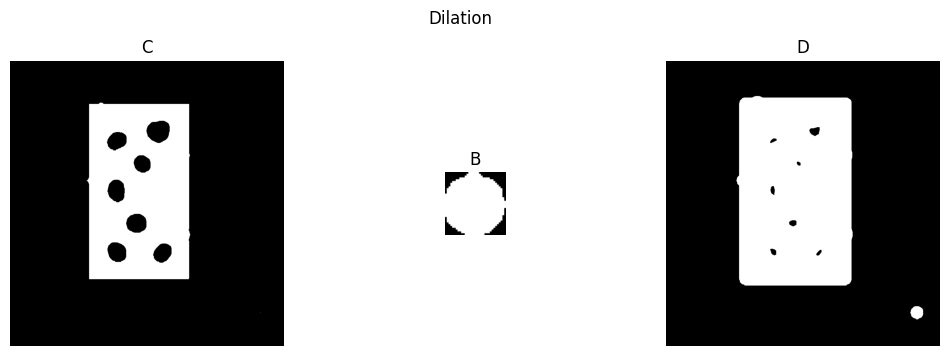

In [3]:
# %% part b
D = cv2.dilate(C, B, iterations=1)

plt.figure(figsize=(12, 4))
plt.suptitle('Dilation')
plt.subplot(1, 3, 1)
plt.imshow(C, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('C')
plt.subplot(1, 13, 7)
plt.imshow(B, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('B')
plt.subplot(1, 3, 3)
plt.imshow(D, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('D')
plt.show()

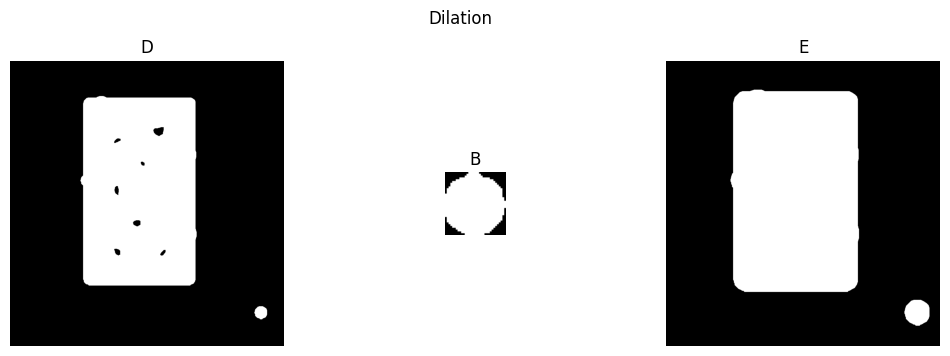

In [4]:
# %% part c
E = cv2.dilate(D, B, iterations=1)

plt.figure(figsize=(12, 4))
plt.suptitle('Dilation')
plt.subplot(1, 3, 1)
plt.imshow(D, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('D')
plt.subplot(1, 13, 7)
plt.imshow(B, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('B')
plt.subplot(1, 3, 3)
plt.imshow(E, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('E')
plt.show()

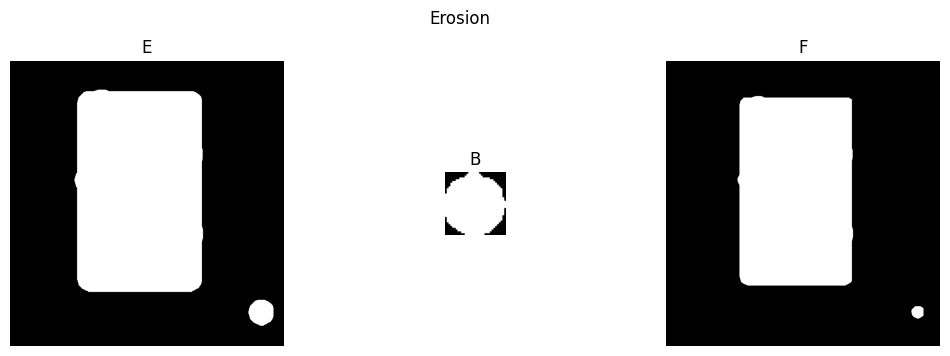

In [5]:
# %% part d
F = cv2.erode(E, B, iterations=1)

plt.figure(figsize=(12, 4))
plt.suptitle('Erosion')
plt.subplot(1, 3, 1)
plt.imshow(E, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('E')
plt.subplot(1, 13, 7)
plt.imshow(B, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('B')
plt.subplot(1, 3, 3)
plt.imshow(F, cmap='gray', vmin=0, vmax=1)
plt.axis('off')
plt.title('F')
plt.show()

---

## Question 2

To show that the Fourier transform of a Gaussian filter in the spatial domain is a Gaussian filter in the frequency domain, we need to compute the Fourier transform of the given Gaussian filter $\mathbf{g}(\mathbf{x}, \mathbf{y})$.

The 2D Fourier transform of a function $f(x, y)$ is given by:

$$
\mathcal{F}\{f(x, y)\} = F(u, v) = \iint_{-\infty}^{\infty} f(x, y) e^{-i2\pi(ux+vy)} \,dx\,dy
$$

where $u$ and $v$ are the spatial frequencies, and $F(u, v)$ is the Fourier transform of $f(x, y)$.

Let's compute the Fourier transform of the given Gaussian filter $\mathbf{g}(\mathbf{x}, \mathbf{y})$:

$$
\begin{aligned}
\mathcal{F}\{\mathbf{g}(\mathbf{x}, \mathbf{y})\} &= \iint_{-\infty}^{\infty} \mathbf{g}(x, y) e^{-i2\pi(ux+vy)} \,dx\,dy \\
&= \iint_{-\infty}^{\infty} \mathbf{A} e^{-\frac{(x^2+y^2)}{2 \sigma^2}} e^{-i2\pi(ux+vy)} \,dx\,dy \\
&= \mathbf{A} \iint_{-\infty}^{\infty} e^{-\frac{x^2}{2 \sigma^2}} e^{-\frac{y^2}{2 \sigma^2}} e^{-i2\pi(ux+vy)} \,dx\,dy \\
&= \mathbf{A} \left(\int_{-\infty}^{\infty} e^{-\frac{x^2}{2 \sigma^2}} e^{-i2\pi ux} \,dx\right) \left(\int_{-\infty}^{\infty} e^{-\frac{y^2}{2 \sigma^2}} e^{-i2\pi vy} \,dy\right) \\
&= \mathbf{A} \left(\sqrt{2\pi}\sigma e^{-2\pi^2 \sigma^2 u^2}\right) \left(\sqrt{2\pi}\sigma e^{-2\pi^2 \sigma^2 v^2}\right) \\
&= 2\pi\sigma^2 \mathbf{A}^2 e^{-2\pi^2 \sigma^2 (u^2+v^2)}
\end{aligned}
$$

So, the Fourier transform of the Gaussian filter $\mathbf{g}(\mathbf{x}, \mathbf{y})$ is a Gaussian filter in the frequency domain with standard deviation $\sigma$.

Regarding whether the filter obtained in the frequency domain is high-pass or low-pass, we can analyze the Gaussian filter in the frequency domain. A Gaussian function in the frequency domain has the property that it decreases rapidly as the frequency moves away from the origin. This means that the Gaussian filter in the frequency domain is a low-pass filter, allowing low-frequency components to pass while attenuating high-frequency components.

---
## Question 3

In the total variation denoising model given, the term $ |u-v|_p^p $ represents the data fidelity term, where $ u $ is the denoised image, $ v $ is the noisy image, and $ p $ is a parameter that controls the behavior of the denoising process.

For salt-pepper noise removal, where pixel values are either 0 or 1, the correct value of $ p $ would be 1. This is because the $ |u-v|_p^p $ term should penalize the difference between $ u $ and $ v $ only when they are not equal. When $ p = 1 $, the term $ |u-v|_1^1 $ is equivalent to the total number of pixels where $ u $ and $ v $ are different, which is the correct behavior for salt-pepper noise removal.

Thus, the correct relationship for salt-pepper noise removal is:

$ u=\underset{u}{\operatorname{argmin}}\left(\int_{\Omega}|\nabla u| d \mathbf{x}+\lambda \int_{\Omega}|u-v|_1^1 d \mathbf{x}\right) $

---

## Coding section

In [6]:
import time
from skimage.transform import resize
from skimage.util import random_noise
from skimage.data import shepp_logan_phantom
from skimage.metrics import peak_signal_noise_ratio
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import cv2
import numpy as np

In [7]:
plt.rcParams.update({"font.family": "serif", "font.serif": ["Times New Roman"], "text.usetex": False})  # Use system font

## Question 1
### Part a

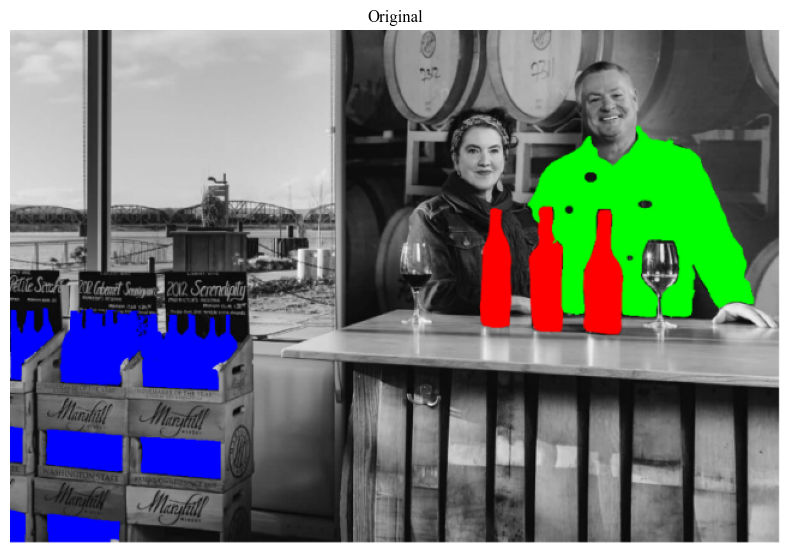

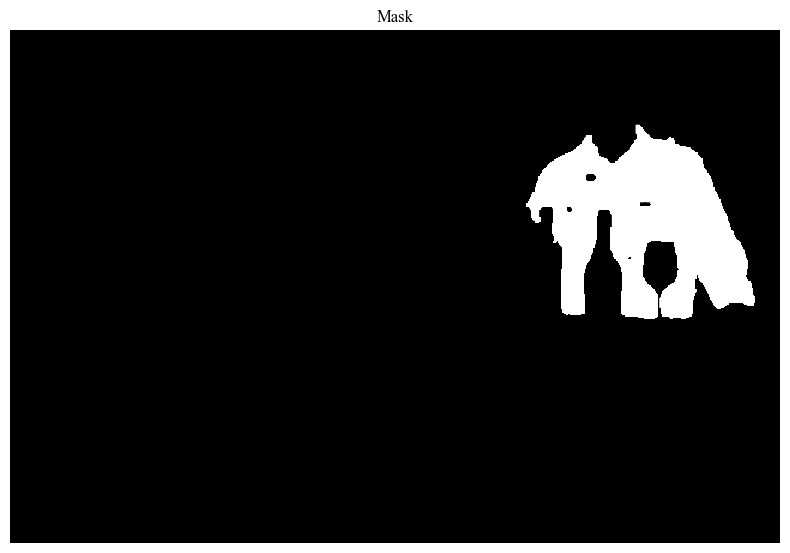

In [8]:
# %% Question 1
# %% part a
image = cv2.imread("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/1/q1.png")

plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), cmap=cm.gray, vmin=0, vmax=1)
plt.title('Original')
plt.axis('off')
plt.tight_layout()
plt.show()

hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

lower_green = np.array([35, 50, 50])
upper_green = np.array([85, 255, 255])

mask = cv2.inRange(hsv, lower_green, upper_green)

cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/1/q1res01.jpg", mask)

plt.figure(figsize=(8, 8))
plt.imshow(mask, cmap=cm.gray, vmin=0, vmax=1)
plt.title('Mask')
plt.axis('off')
plt.tight_layout()
plt.show()

### Part b

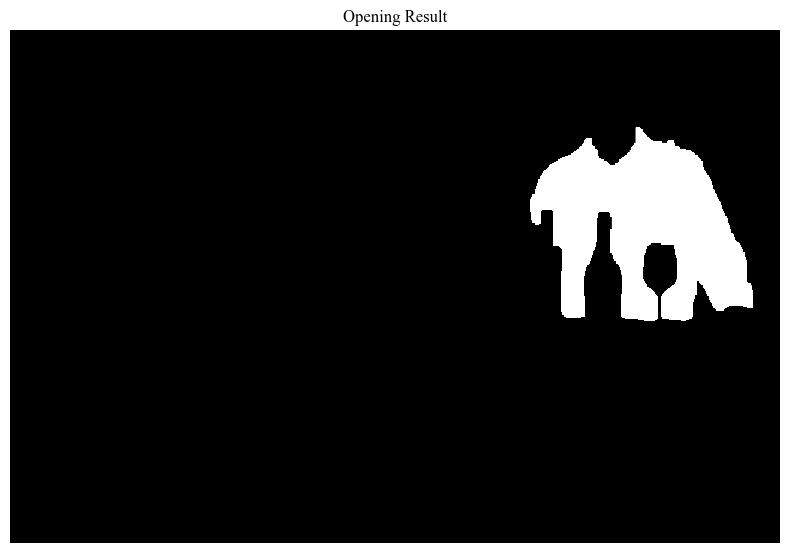

In [9]:
# %% part b
kernel = np.ones((10, 3))

closing = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
opening = cv2.morphologyEx(closing, cv2.MORPH_OPEN, kernel)

cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/1/q1res02.jpg", opening)

plt.figure(figsize=(8, 8))
plt.imshow(opening, cmap=cm.gray, vmin=0, vmax=1)
plt.title('Opening Result')
plt.axis('off')
plt.tight_layout()
plt.show()

### Part c

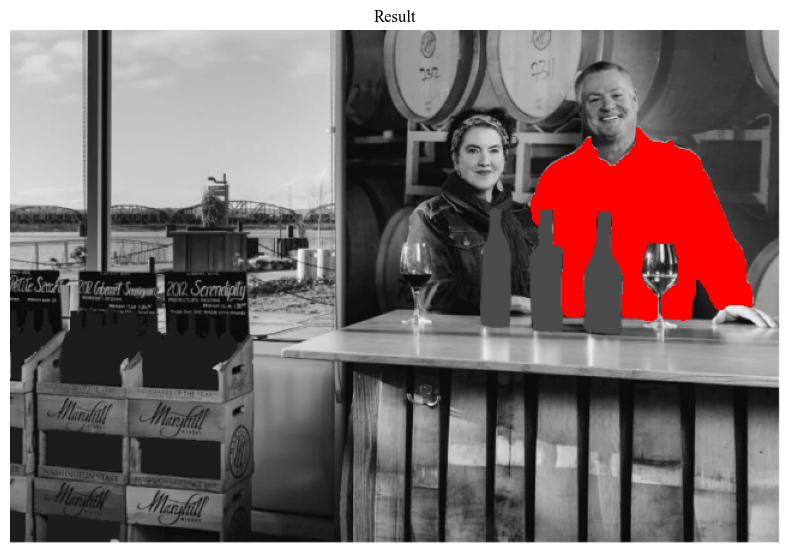

In [10]:
# %% part c
gray_image = cv2.imread("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/1/q1.png", cv2.IMREAD_GRAYSCALE)
gray_image = cv2.merge((gray_image, gray_image, gray_image))

red_mask = cv2.merge((np.zeros_like(opening), np.zeros_like(opening), opening))

result = gray_image.copy()
for j in range(len(result[0])):
    for i in range(len(result)):
        if red_mask[i, j, 2] == 255:
            result[i, j, 0] = 0
            result[i, j, 1] = 0
            result[i, j, 2] = 255

cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/1/q1res03.jpg", result)

#cv2.imshow("Result", result)
#cv2.waitKey(0)
#cv2.destroyAllWindows()

plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB), cmap=cm.gray, vmin=0, vmax=1)
plt.title('Result')
plt.axis('off')
plt.tight_layout()
plt.show()

In the code, I used several image processing techniques to achieve the final result:

1. **Color Thresholding:** I initially used color thresholding in the HSV color space to create a binary mask (`q1res01.jpg`) that identifies the green pixels corresponding to the clothing.

2. **Morphological Closing:** The closing operation (`cv2.MORPH_CLOSE`) is used to fill small holes inside the mask. This is done using a square kernel of size 10x3 (`np.ones((10, 3), np.uint8)`) to ensure that small gaps or holes within the clothing area are filled.

3. **Morphological Opening:** The opening operation (`cv2.MORPH_OPEN`) is then applied to the result of the closing operation to remove any noise outside the clothing area. This helps in smoothing out the edges of the clothing and removing any artifacts that may have been introduced during the closing operation.

4. **Masking and Coloring:** Finally, I apply the cleaned mask to the original image to redden the areas corresponding to the person's clothes. I set the BGR values of these pixels to red (0, 0, 255) to highlight the clothing. The areas outside the clothing are grayscaled.


---

## Question 2
### Part a

In [11]:
# %% Question 2
# %% part a
gray_image = cv2.imread("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/2/hand.jpg", cv2.IMREAD_GRAYSCALE)
gray_image = cv2.normalize(gray_image, None, 0, 1, cv2.NORM_MINMAX, dtype=cv2.CV_32F)  # normalized image
# gray_image = gray_image/255 # normalized image

mean = 0.05  # image is normilized
var = 0.01
sigma = var**0.5
gaussian = np.zeros_like(gray_image)
gaussian = cv2.randn(gaussian, mean, sigma)

noisy_gray_image = cv2.add(gray_image, gaussian)

cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/2/hand_noisy.jpg", noisy_gray_image * 255)

True

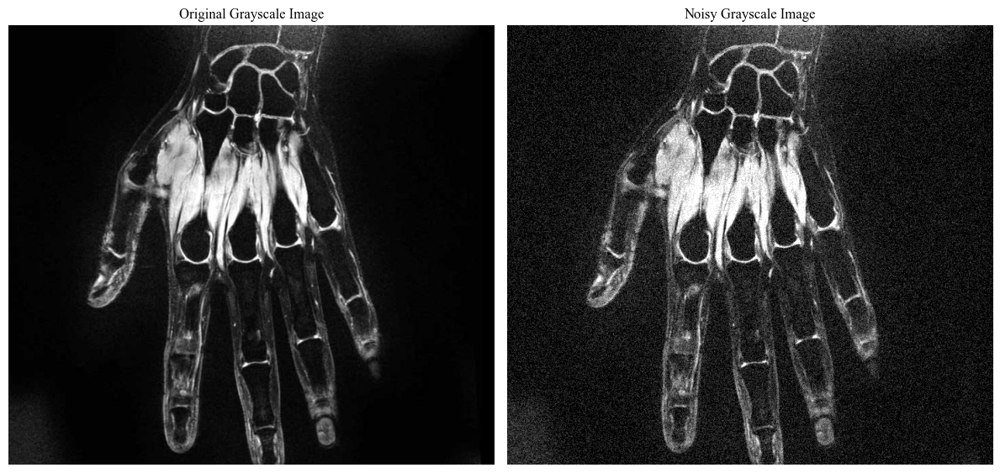

In [12]:
plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.imshow(gray_image, cmap=cm.gray, vmin=0, vmax=1)
plt.title("Original Grayscale Image")
plt.tight_layout()
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(noisy_gray_image, cmap=cm.gray, vmin=0, vmax=1)
plt.title("Noisy Grayscale Image")
plt.axis("off")
plt.tight_layout()
plt.show()

### Part b

In [13]:
# %% part b
def gaussian_kernel(distance, hx):
    return np.exp(-0.5 * (distance / hx) ** 2)


def classical_regression_filtering(image, hx):
    rows, cols = image.shape
    denoised_image = np.zeros_like(image, dtype=np.float64)
    epsilon = 1e-8
    for i in range(rows):
        for j in range(cols):
            neighborhood = image[max(i - 1, 0): min(i + 2, rows), max(j - 1, 0): min(j + 2, cols)]
            distances = np.sqrt((neighborhood - image[i, j]) ** 2)
            weights = gaussian_kernel(distances, hx)
            denoised_image[i, j] = np.sum(weights * neighborhood) / (np.sum(weights) + epsilon)

    return denoised_image

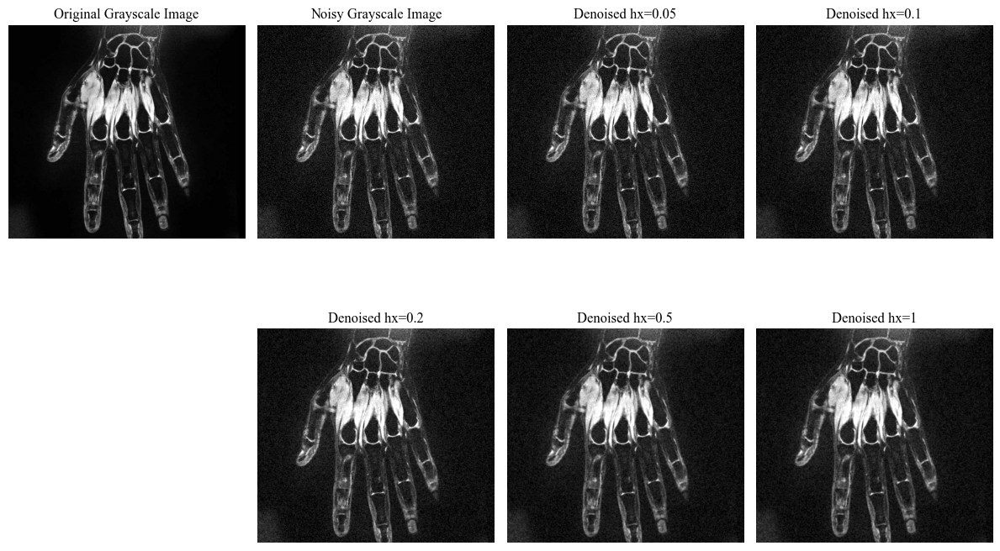

In [14]:
plt.figure(figsize=(12, 8))

plt.subplot(2, 4, 1)
plt.imshow(gray_image, cmap=cm.gray, vmin=0, vmax=1)
plt.title("Original Grayscale Image")
plt.axis("off")
plt.tight_layout()

plt.subplot(2, 4, 2)
plt.imshow(noisy_gray_image, cmap=cm.gray, vmin=0, vmax=1)
plt.title("Noisy Grayscale Image")
plt.axis("off")
plt.tight_layout()

cnt = 3
hxs = [0.05, 0.1, 0.2, 0.5, 1]
for hx in hxs:
    # hx is smoothing parameter
    denoised_image = classical_regression_filtering(noisy_gray_image, hx)
    if cnt == 5:
        cnt += 1
    plt.subplot(2, 4, cnt)
    plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"Denoised hx={hx}")
    plt.axis("off")
    cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/2/hand_denoised_hx{hx}.jpg", denoised_image * 255)
    cnt += 1
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/2/hand_denoised_classical_regression_filtering.jpg", dpi=320)


The given Gaussian kernel formulation is used for Classical Regression Filtering to estimate the denoised image. This kernel works by assigning weights to the neighboring pixels of a particular pixel in the image. The weights are determined based on the similarity between the pixel being processed (X) and its neighbors (Y), as well as the smoothing parameter (hx).

Steps:
1. For each pixel X in the noisy image, a neighborhood around X is defined.
2. The similarity between X and each pixel Y in the neighborhood is measured. This similarity is calculated as the Euclidean distance between X and Y, normalized by the smoothing parameter hx.
3. The Gaussian kernel is applied to these distances, giving higher weights to pixels that are closer to X and lower weights to pixels that are farther away.
4. The pixel values in the neighborhood are weighted by these Gaussian weights and combined to estimate the denoised value for pixel X.


### Part c

In [15]:
# %% part c
def bilateral_filter(image, hx, hg):
    rows, cols = image.shape
    denoised_image = np.zeros_like(image, dtype=np.float64)
    epsilon = 1e-8
    for i in range(rows):
        for j in range(cols):
            neighborhood = image[max(i - 1, 0): min(i + 2, rows), max(j - 1, 0): min(j + 2, cols)]
            spatial_weights = np.exp(-0.5 * ((neighborhood - image[i, j]) ** 2) / (hx**2))
            intensity_weights = np.exp(-0.5 * ((neighborhood - neighborhood[1, 1]) ** 2) / (hg**2))
            bilateral_weights = spatial_weights * intensity_weights
            denoised_image[i, j] = np.sum(bilateral_weights * neighborhood) / (np.sum(bilateral_weights) + epsilon)

    return denoised_image

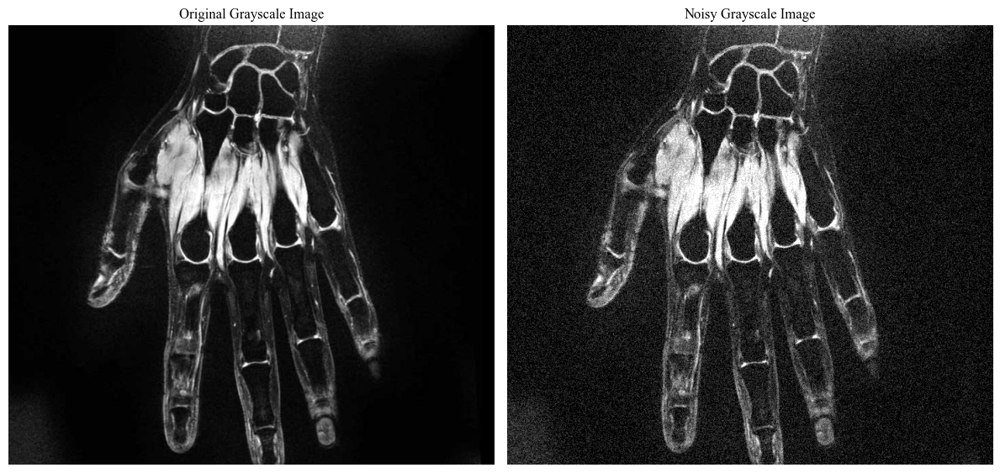

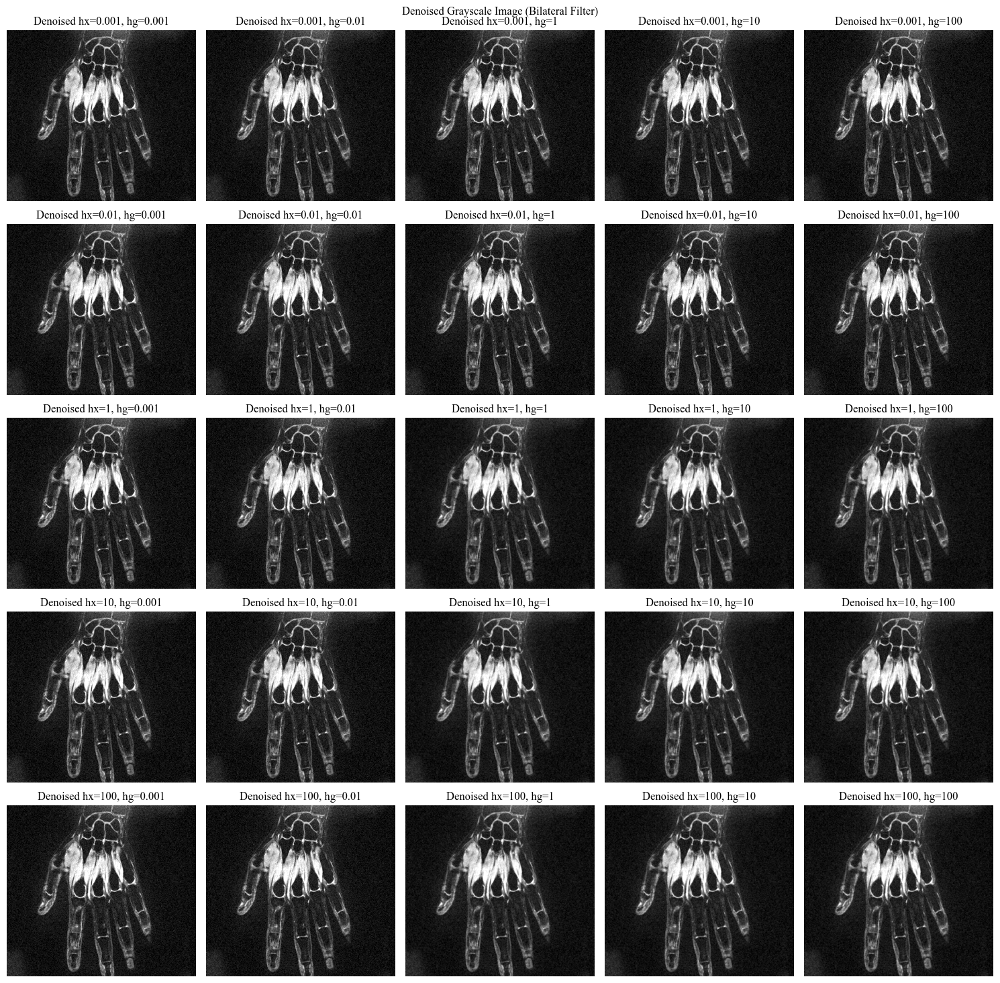

In [16]:
hxs = [0.001, 0.01, 1, 10, 100]
hgs = [0.001, 0.01, 1, 10, 100]

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.imshow(gray_image, cmap=cm.gray, vmin=0, vmax=1)
plt.title("Original Grayscale Image")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(noisy_gray_image, cmap=cm.gray, vmin=0, vmax=1)
plt.title("Noisy Grayscale Image")
plt.axis("off")
plt.tight_layout()
plt.show()

plt.figure(figsize=(15, 15))
plt.suptitle("Denoised Grayscale Image (Bilateral Filter)")
cnt = 1
for hx in hxs:
    for hg in hgs:
        denoised_image_bilateral = bilateral_filter(noisy_gray_image, hx, hg)

        plt.subplot(5, 5, cnt)
        plt.imshow(denoised_image_bilateral, cmap=cm.gray, vmin=0, vmax=1)
        plt.title(f"Denoised hx={hx}, hg={hg}")
        cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/2/hand_denoised_bilateral_hx{hx}_hg{hg}.jpg", denoised_image_bilateral * 255)
        plt.axis("off")
        cnt += 1
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/2/hand_denoised_bilateral_filtering.jpg", dpi=320)

Bilateral Filtering is a non-linear filtering technique used for smoothing images while preserving edges. It works by considering both the spatial distance between pixels (X and Y) and the intensity or color difference between pixels (g(X) and g(Y)).

Steps:
1. For each pixel X in the noisy image, a window around X is defined.
2. The filter calculates two Gaussian weights: one based on the spatial distance between X and Y (controlled by hx), and the other based on the intensity difference between g(X) and g(Y) (controlled by hg).
3. These Gaussian weights are combined to form the Bilateral Filter kernel. The spatial weight ensures that nearby pixels have higher influence, while the intensity weight ensures that pixels with similar intensities are given higher weights.
4. The pixel values in the window are weighted by these Bilateral Filter kernel weights and combined to estimate the denoised value for pixel X.

### Part *
The parameters hx and hg in the Bilateral Filter control the influence of spatial and intensity information, respectively, on the filtering process.

1. **hx (Spatial Information):** This parameter determines the extent of the spatial neighborhood considered when filtering a pixel. A larger hx means that pixels farther away from the center pixel will have a greater influence on the filtering result. Pictures with more pronounced edges and features (such as images with sharp transitions between objects or high-frequency textures) may benefit from a larger hx to preserve these details. However, using too large a hx can result in oversmoothing, so it's important to find a balance based on the characteristics of the image.

2. **hg (Intensity or Lighting Information):** This parameter controls how much the intensity or color difference between pixels affects the filtering. A larger hg gives more weight to pixels with similar intensity values, effectively preserving edges and details in regions with gradual intensity changes. Images with varying lighting conditions or smooth intensity gradients may benefit from a larger hg to maintain these subtle variations. However, using a very large hg can lead to insufficient noise reduction, so it should be chosen carefully based on the specific image characteristics.

In summary, pictures with pronounced edges and features may require a larger hx to preserve details, while pictures with varying lighting conditions or smooth intensity gradients may benefit from a larger hg to maintain subtle variations. The optimal values of hx and hg depend on the specific characteristics of the image and the desired denoising effect.

---

## Question 3
### Part a

In [17]:
# %% Question 3
# %% part a

image1 = cv2.imread("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1.png", cv2.IMREAD_GRAYSCALE)
image2 = cv2.imread("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2.png", cv2.IMREAD_GRAYSCALE)
image1 = cv2.normalize(image1, None, 0, 1, cv2.NORM_MINMAX, dtype=cv2.CV_32F)  # normalized image
image2 = cv2.normalize(image2, None, 0, 1, cv2.NORM_MINMAX, dtype=cv2.CV_32F)  # normalized image


def add_gaussian_noise(image, mean, var):
    sigma = var**0.5
    gauss = np.zeros_like(image)
    gauss = cv2.randn(gauss, mean, sigma)
    return cv2.add(image, gauss)


def add_pepper_salt_noise(image, prob):
    row, col = image.shape
    noisy = np.copy(image)
    num_salt = np.ceil(prob * image.size)
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy[coords[0], coords[1]] = 1
    num_pepper = np.ceil(prob * image.size)
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy[coords[0], coords[1]] = 0
    return noisy


def nlm_denoise(image, W, Wsim, sigma):
    """
    Non-Local Means (NLM)

    Parameters:
    - image: Input grayscale image (normalized).
    - W: Window size for patch comparison.
    - Wsim: Window size for similarity weighting.
    - sigma: Standard deviation of the Gaussian noise.

    Returns:
    - Denoised image.
    """
    h, w = image.shape
    pad = Wsim // 2 + W // 2

    padded_image = np.pad(image, pad, mode="constant")

    denoised_image = np.zeros_like(image, dtype=np.float64)

    for i in range(pad, h + pad):
        for j in range(pad, w + pad):
            patch = padded_image[i - W // 2: i + W // 2 + 1, j - W // 2: j + W // 2 + 1]

            weights = np.zeros_like(patch, dtype=np.float64)
            for k in range(i - Wsim // 2, i + Wsim // 2 + 1):
                for l in range(j - Wsim // 2, j + Wsim // 2 + 1):
                    if k == i and l == j:
                        continue
                    patch2 = padded_image[k - W // 2: k + W // 2 + 1, l - W // 2: l + W // 2 + 1]
                    diff = patch - patch2
                    weights[k - (i - Wsim // 2), l - (j - Wsim // 2)] = np.exp(-np.sum(diff**2) / (sigma**2))

            weights /= np.sum(weights)

            denoised_image[i - pad, j - pad] = np.sum(weights * patch)

    return denoised_image

#### 0.05, 0.01 - NLM - IMG1

C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\1502156677.py:14: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr = peak_signal_noise_ratio(image1, denoised_image)


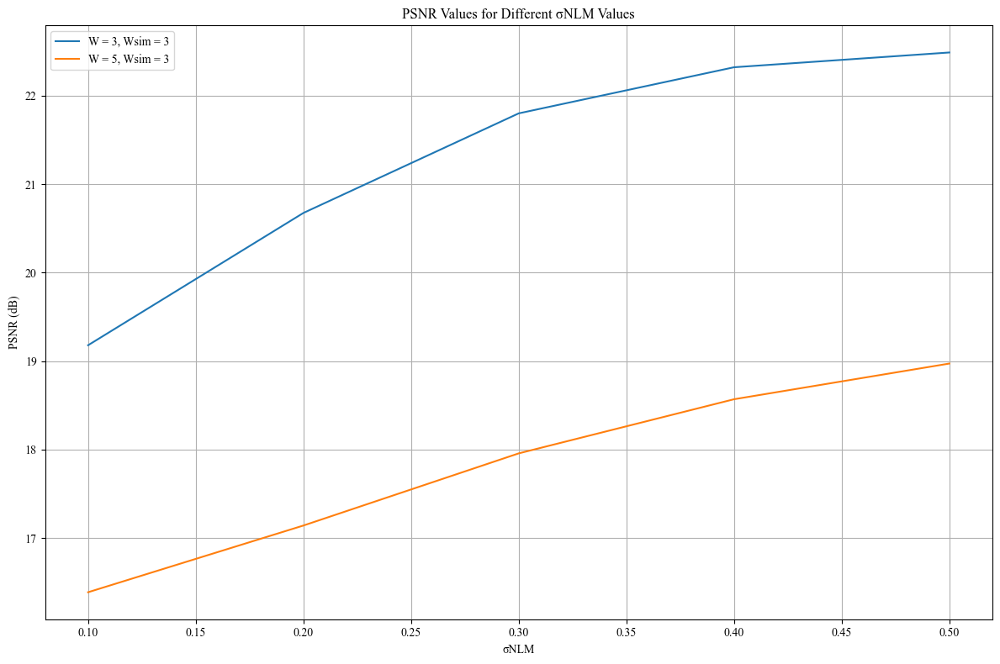

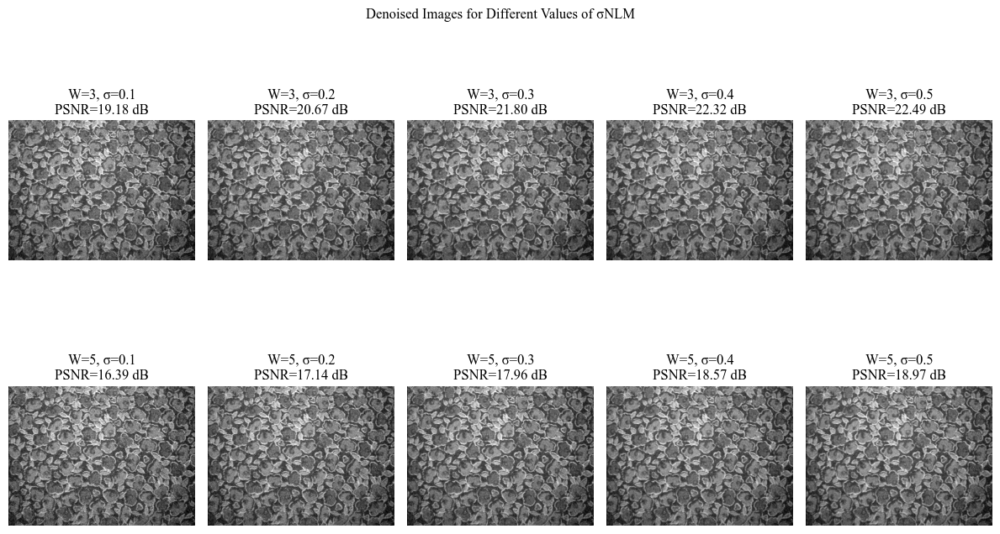

In [18]:
# %% 0.05, 0.01 - NLM
# for Image1
noisy_image1 = add_pepper_salt_noise(image1, 0.01)
noisy_image1 = add_gaussian_noise(noisy_image1, 0.05, 0.01)
cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/0.05_0.01/image1_noisy_0.05_0.01.jpg", noisy_image1 * 255)

W_values = [3, 5]
Wsim = 3
sigma_values = np.arange(0.1, 0.6, 0.1)
psnr_values_image1 = []
for W in W_values:
    for sigma in sigma_values:
        denoised_image = nlm_denoise(noisy_image1, sigma=sigma, W=W, Wsim=Wsim)
        psnr = peak_signal_noise_ratio(image1, denoised_image)
        cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/0.05_0.01/image1_noisy_denoised_W{W}_sigma{sigma}_psnr{psnr:.2f}.jpg", denoised_image * 255)
        psnr_values_image1.append((W, sigma, psnr, denoised_image))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σNLM Values")
plt.xlabel("σNLM")
plt.ylabel("PSNR (dB)")

for W in W_values:
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    sigma_values_W = [sigma for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    plt.plot(sigma_values_W, psnr_W, label=f"W = {W}, Wsim = {Wsim}")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/0.05_0.01/image1_psnr.jpg", dpi=320)


plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σNLM", y=0.95)

for idx, (W, sigma, psnr, denoised_image) in enumerate(psnr_values_image1, start=1):
    plt.subplot(len(W_values), len(sigma_values), idx)
    plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"W={W}, σ={sigma:.1f}\nPSNR={psnr:.2f} dB")
    plt.axis("off")

plt.tight_layout()
plt.show()

#### 0.5, 0.1 - NLM - IMG1

C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\930245244.py:62: RuntimeWarning: invalid value encountered in divide
  weights /= np.sum(weights)
C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\13478221.py:14: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr = peak_signal_noise_ratio(image1, denoised_image)


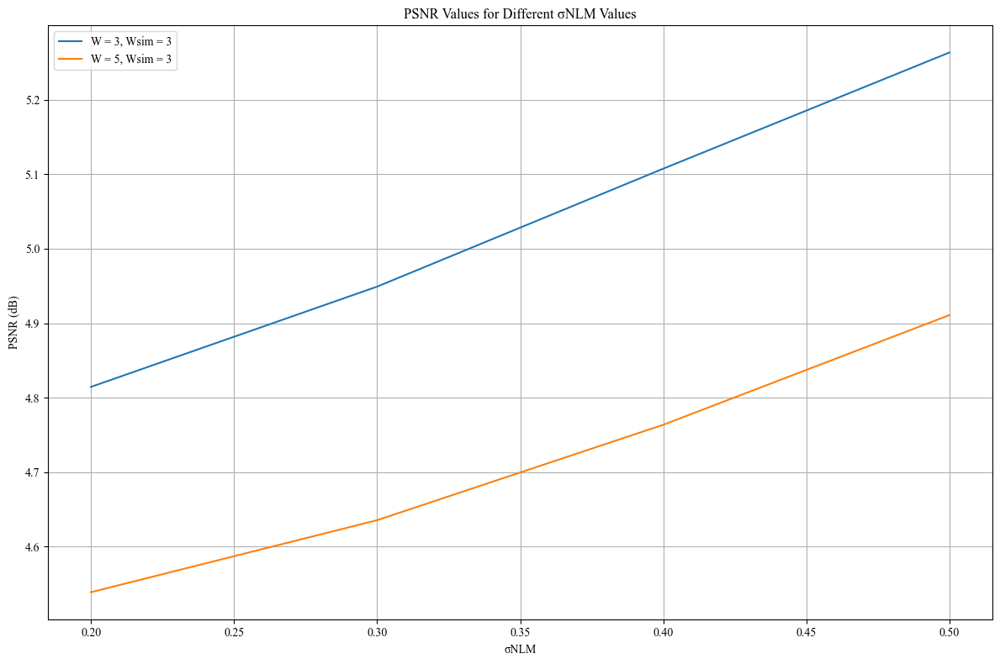

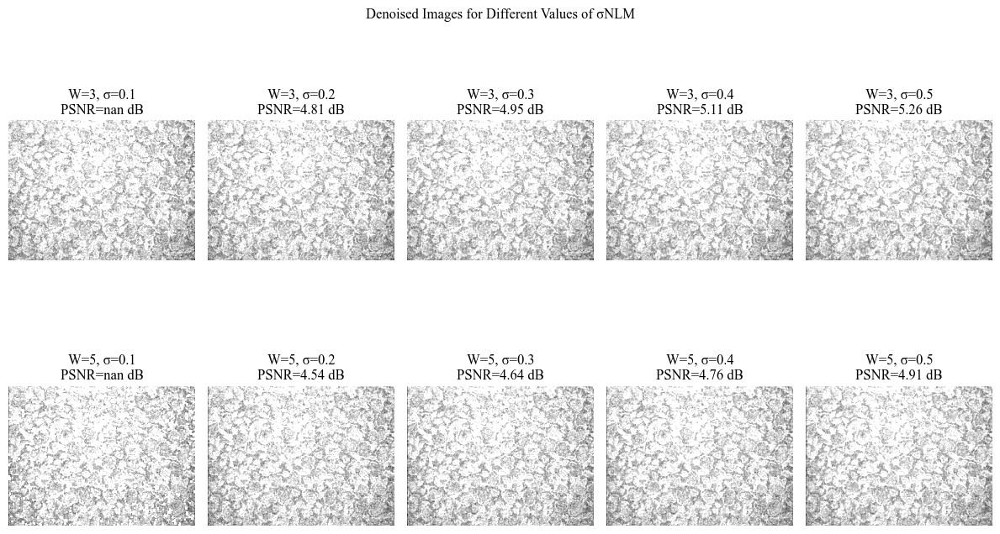

In [19]:
# %% 0.5, 0.1 - NLM
# for Image1
noisy_image1 = add_pepper_salt_noise(image1, 0.01)
noisy_image1 = add_gaussian_noise(noisy_image1, 0.5, 0.1)
cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/0.5_0.1/image1_noisy_0.5_0.1.jpg", noisy_image1 * 255)

W_values = [3, 5]
Wsim = 3
sigma_values = np.arange(0.1, 0.6, 0.1)
psnr_values_image1 = []
for W in W_values:
    for sigma in sigma_values:
        denoised_image = nlm_denoise(noisy_image1, sigma=sigma, W=W, Wsim=Wsim)
        psnr = peak_signal_noise_ratio(image1, denoised_image)
        cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/0.5_0.1/image1_noisy_denoised_W{W}_sigma{sigma}_psnr{psnr:.2f}.jpg", denoised_image * 255)
        psnr_values_image1.append((W, sigma, psnr, denoised_image))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σNLM Values")
plt.xlabel("σNLM")
plt.ylabel("PSNR (dB)")

for W in W_values:
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    sigma_values_W = [sigma for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    plt.plot(sigma_values_W, psnr_W, label=f"W = {W}, Wsim = {Wsim}")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/0.5_0.1/image1_psnr.jpg", dpi=320)


plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σNLM", y=0.95)

for idx, (W, sigma, psnr, denoised_image) in enumerate(psnr_values_image1, start=1):
    plt.subplot(len(W_values), len(sigma_values), idx)
    plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"W={W}, σ={sigma:.1f}\nPSNR={psnr:.2f} dB")
    plt.axis("off")

plt.tight_layout()
plt.show()

#### 0.05, 0.01 - NLM - IMG2

C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\2567340961.py:14: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr = peak_signal_noise_ratio(image2, denoised_image)


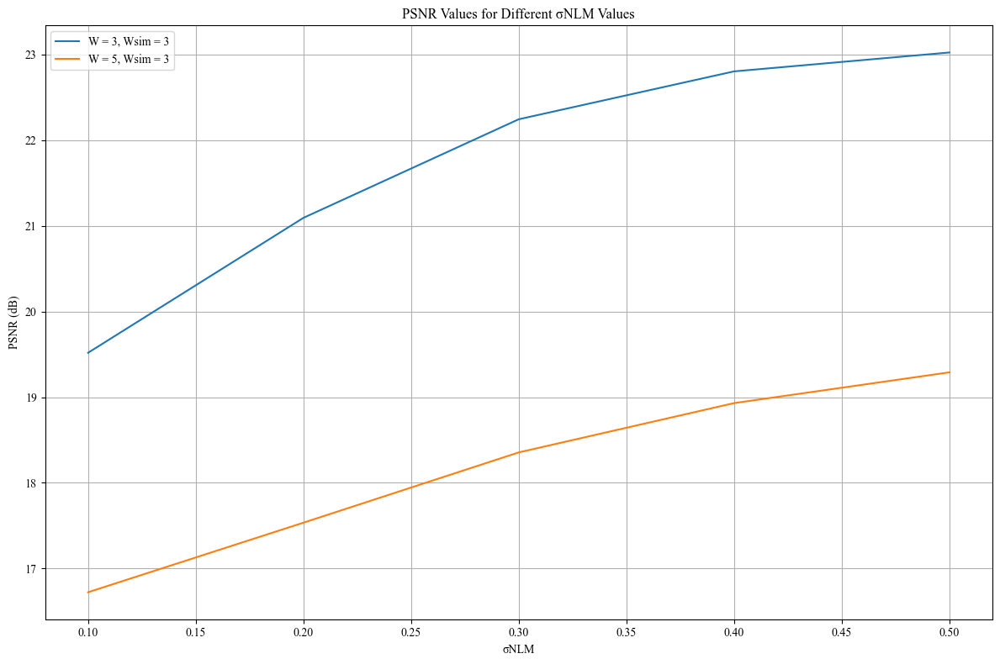

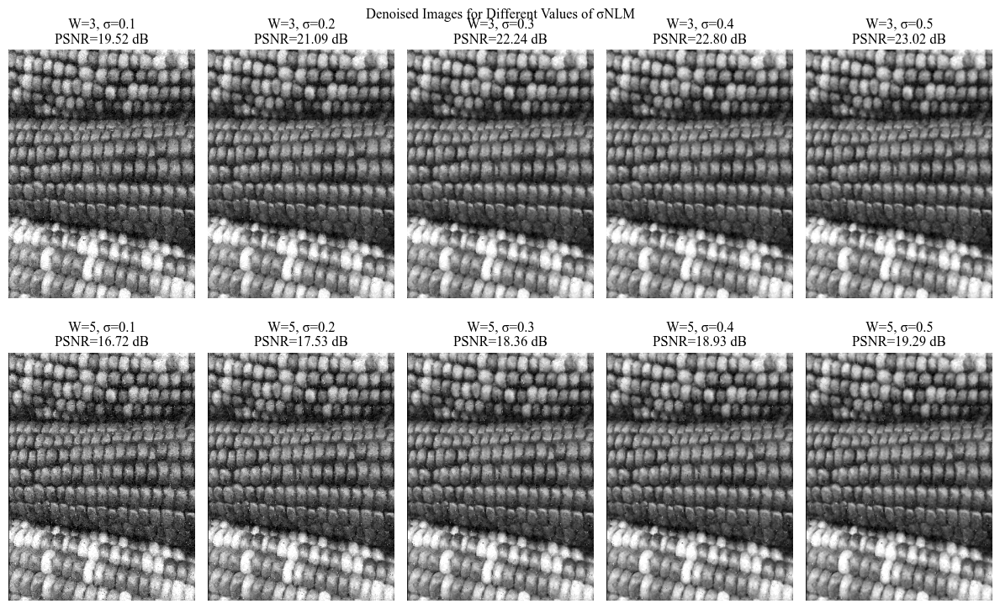

In [20]:
# %% 0.05, 0.01 - NLM
# for Image2
noisy_image2 = add_pepper_salt_noise(image2, 0.01)
noisy_image2 = add_gaussian_noise(noisy_image2, 0.05, 0.01)
cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/0.05_0.01/image2_noisy_0.05_0.01.jpg", noisy_image2 * 255)

W_values = [3, 5]
Wsim = 3
sigma_values = np.arange(0.1, 0.6, 0.1)
psnr_values_image2 = []
for W in W_values:
    for sigma in sigma_values:
        denoised_image = nlm_denoise(noisy_image2, sigma=sigma, W=W, Wsim=Wsim)
        psnr = peak_signal_noise_ratio(image2, denoised_image)
        cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/0.05_0.01/image2_noisy_denoised_W{W}_sigma{sigma}_psnr{psnr:.2f}.jpg", denoised_image * 255)
        psnr_values_image2.append((W, sigma, psnr, denoised_image))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σNLM Values")
plt.xlabel("σNLM")
plt.ylabel("PSNR (dB)")

for W in W_values:
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    sigma_values_W = [sigma for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    plt.plot(sigma_values_W, psnr_W, label=f"W = {W}, Wsim = {Wsim}")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/0.05_0.01/image2_psnr.jpg", dpi=320)


plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σNLM", y=0.95)

for idx, (W, sigma, psnr, denoised_image) in enumerate(psnr_values_image2, start=1):
    plt.subplot(len(W_values), len(sigma_values), idx)
    plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"W={W}, σ={sigma:.1f}\nPSNR={psnr:.2f} dB")
    plt.axis("off")

plt.tight_layout()
plt.show()

#### 0.5, 0.1 - NLM - IMG2

C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\930245244.py:62: RuntimeWarning: invalid value encountered in divide
  weights /= np.sum(weights)
C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\3401627946.py:14: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr = peak_signal_noise_ratio(image2, denoised_image)


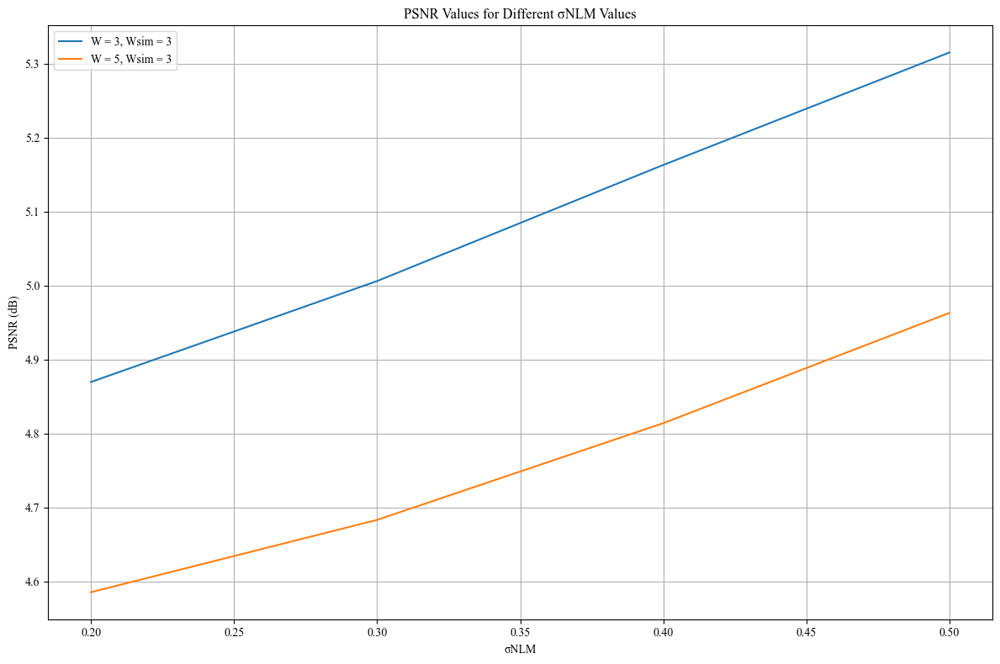

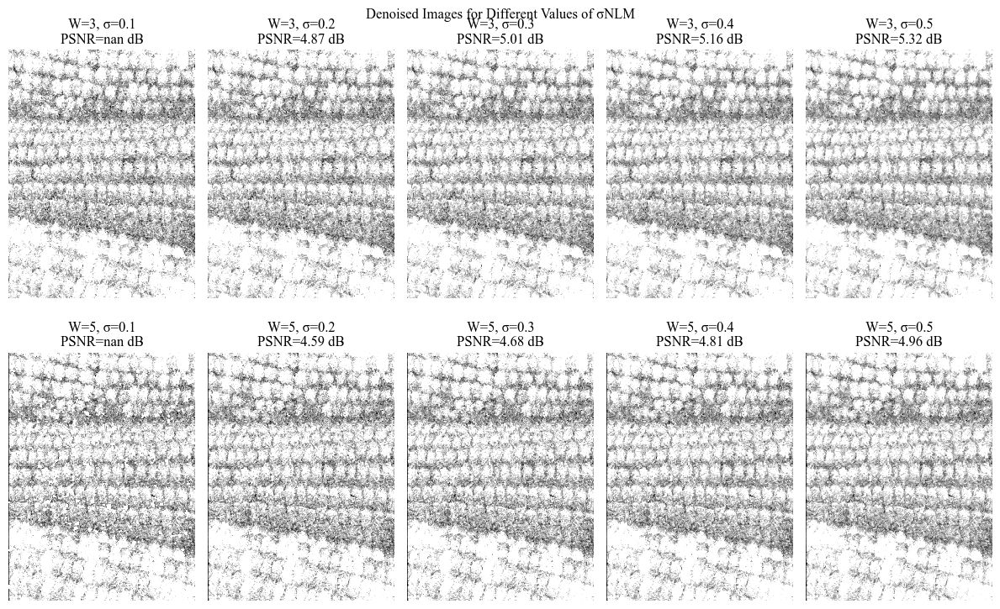

In [21]:
# %% 0.5, 0.1 - NLM
# for Image2
noisy_image2 = add_pepper_salt_noise(image2, 0.01)
noisy_image2 = add_gaussian_noise(noisy_image2, 0.5, 0.1)
cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/0.5_0.1/image2_noisy_0.5_0.1.jpg", noisy_image2 * 255)

W_values = [3, 5]
Wsim = 3
sigma_values = np.arange(0.1, 0.6, 0.1)
psnr_values_image2 = []
for W in W_values:
    for sigma in sigma_values:
        denoised_image = nlm_denoise(noisy_image2, sigma=sigma, W=W, Wsim=Wsim)
        psnr = peak_signal_noise_ratio(image2, denoised_image)
        cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/0.5_0.1/image2_noisy_denoised_W{W}_sigma{sigma}_psnr{psnr:.2f}.jpg", denoised_image * 255)
        psnr_values_image2.append((W, sigma, psnr, denoised_image))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σNLM Values")
plt.xlabel("σNLM")
plt.ylabel("PSNR (dB)")

for W in W_values:
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    sigma_values_W = [sigma for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    plt.plot(sigma_values_W, psnr_W, label=f"W = {W}, Wsim = {Wsim}")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/0.5_0.1/image2_psnr.jpg", dpi=320)


plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σNLM", y=0.95)

for idx, (W, sigma, psnr, denoised_image) in enumerate(psnr_values_image2, start=1):
    plt.subplot(len(W_values), len(sigma_values), idx)
    plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"W={W}, σ={sigma:.1f}\nPSNR={psnr:.2f} dB")
    plt.axis("off")

plt.tight_layout()
plt.show()

### Part b.1

#### 0.05, 0.01 - Gaussian - IMG1

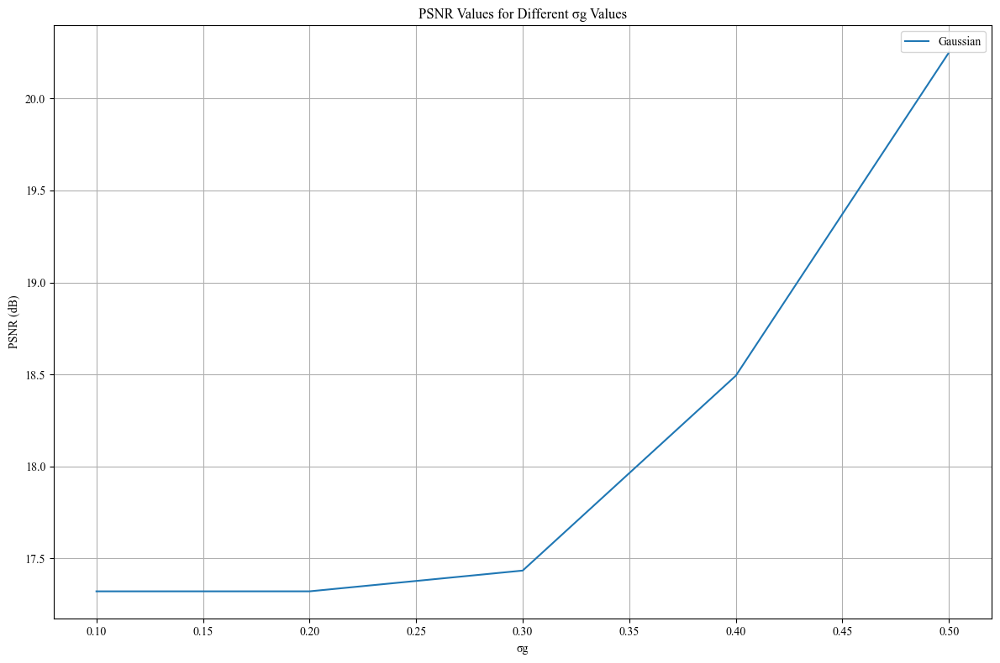

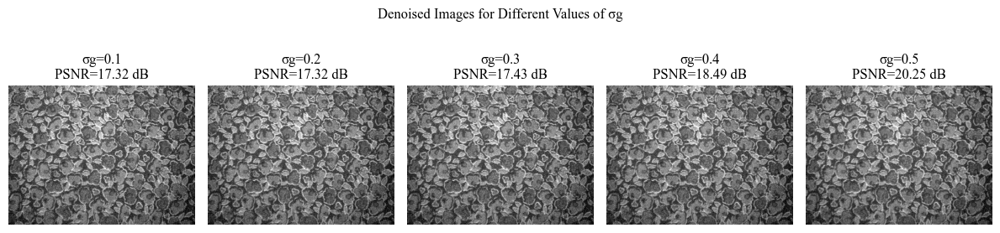

In [22]:
# %% 0.05, 0.01 - Gaussian
# for Image1
noisy_image1 = add_pepper_salt_noise(image1, 0.01)
noisy_image1 = add_gaussian_noise(noisy_image1, 0.05, 0.01)
cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/gaussian/0.05_0.01/image1_noisy_0.05_0.01.jpg", noisy_image1 * 255)

sigma_g_values = np.arange(0.1, 0.6, 0.1)
kernel_size = 77

psnr_values_gaussian_image1 = []
for sigma_g in sigma_g_values:
    denoised_image_gaussian = cv2.GaussianBlur(noisy_image1, (kernel_size, kernel_size), sigma_g)
    psnr_gaussian = peak_signal_noise_ratio(image1, denoised_image_gaussian)
    cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/gaussian/0.05_0.01/image1_noisy_denoised_sigmag{sigma_g:.1f}_psnr{psnr_gaussian:.2f}.jpg", denoised_image_gaussian * 255)
    psnr_values_gaussian_image1.append(("Gaussian", sigma_g, psnr_gaussian, denoised_image_gaussian))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σg Values")
plt.xlabel("σg")
plt.ylabel("PSNR (dB)")

psnr_gaussian_values = [psnr_gaussian for (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in psnr_values_gaussian_image1]
sigma_gaussian_values = [sigma_g for (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in psnr_values_gaussian_image1]
plt.plot(sigma_gaussian_values, psnr_gaussian_values, label="Gaussian")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/gaussian/0.05_0.01/image1_psnr.jpg", dpi=320)


plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σg", y=0.7)

for idx, (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in enumerate(psnr_values_gaussian_image1, start=1):
    plt.subplot(1, len(sigma_g_values), idx)
    plt.imshow(denoised_image_gaussian, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"σg={sigma_g:.1f}\nPSNR={psnr_gaussian:.2f} dB")
    plt.axis("off")

plt.tight_layout()
plt.show()

#### 0.5, 0.1 - Gaussian - IMG1

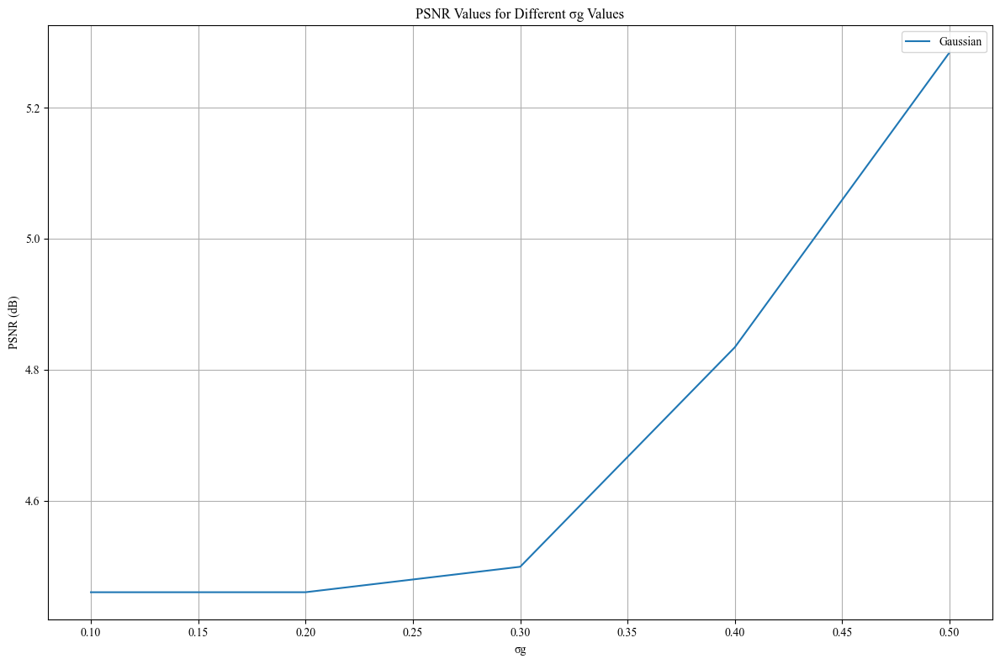

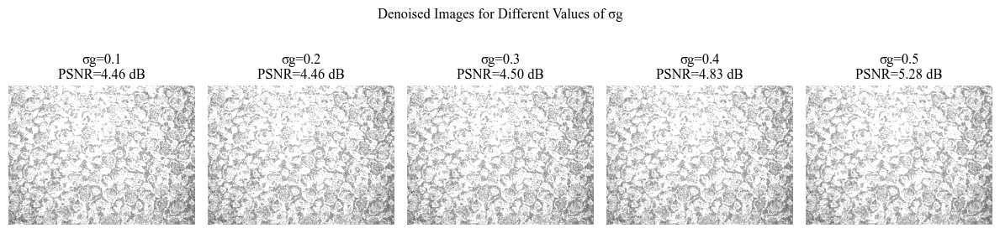

In [23]:
# %% 0.5, 0.1 - Gaussian
# for Image1
noisy_image1 = add_pepper_salt_noise(image1, 0.01)
noisy_image1 = add_gaussian_noise(noisy_image1, 0.5, 0.1)
cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/gaussian/0.5_0.1/image1_noisy_0.5_0.1.jpg", noisy_image1 * 255)

sigma_g_values = np.arange(0.1, 0.6, 0.1)
kernel_size = 77

psnr_values_gaussian_image1 = []
for sigma_g in sigma_g_values:
    denoised_image_gaussian = cv2.GaussianBlur(noisy_image1, (kernel_size, kernel_size), sigma_g)
    psnr_gaussian = peak_signal_noise_ratio(image1, denoised_image_gaussian)
    cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/gaussian/0.5_0.1/image1_noisy_denoised_sigmag{sigma_g:.1f}_psnr{psnr_gaussian:.2f}.jpg", denoised_image_gaussian * 255)
    psnr_values_gaussian_image1.append(("Gaussian", sigma_g, psnr_gaussian, denoised_image_gaussian))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σg Values")
plt.xlabel("σg")
plt.ylabel("PSNR (dB)")

psnr_gaussian_values = [psnr_gaussian for (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in psnr_values_gaussian_image1]
sigma_gaussian_values = [sigma_g for (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in psnr_values_gaussian_image1]
plt.plot(sigma_gaussian_values, psnr_gaussian_values, label="Gaussian")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/gaussian/0.5_0.1/image1_psnr.jpg", dpi=320)


plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σg", y=0.7)

for idx, (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in enumerate(psnr_values_gaussian_image1, start=1):
    plt.subplot(1, len(sigma_g_values), idx)
    plt.imshow(denoised_image_gaussian, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"σg={sigma_g:.1f}\nPSNR={psnr_gaussian:.2f} dB")
    plt.axis("off")

plt.tight_layout()
plt.show()

#### 0.05, 0.01 - Gaussian - IMG2

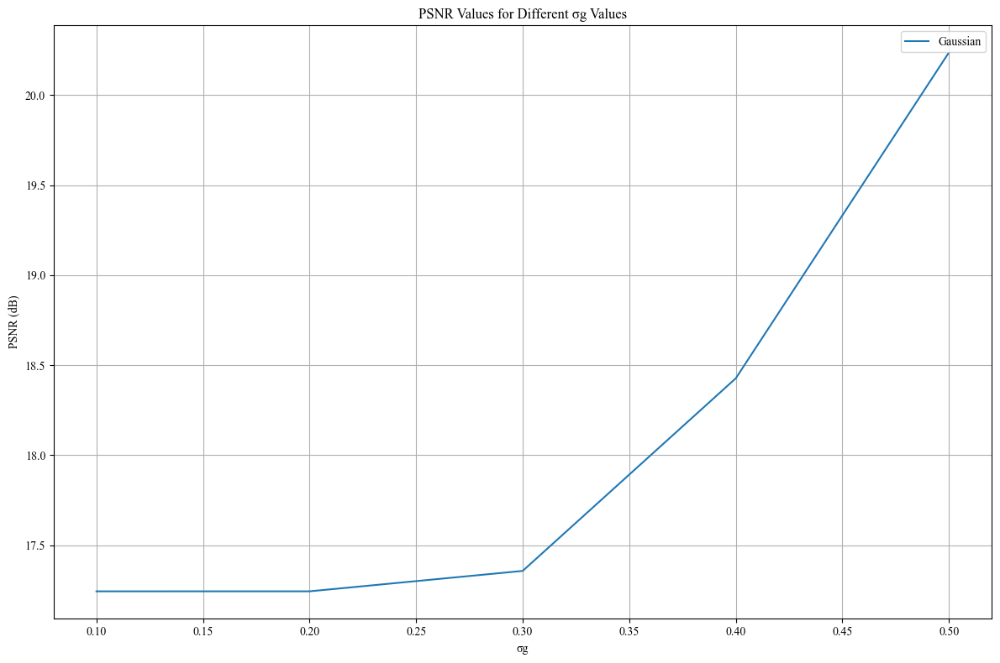

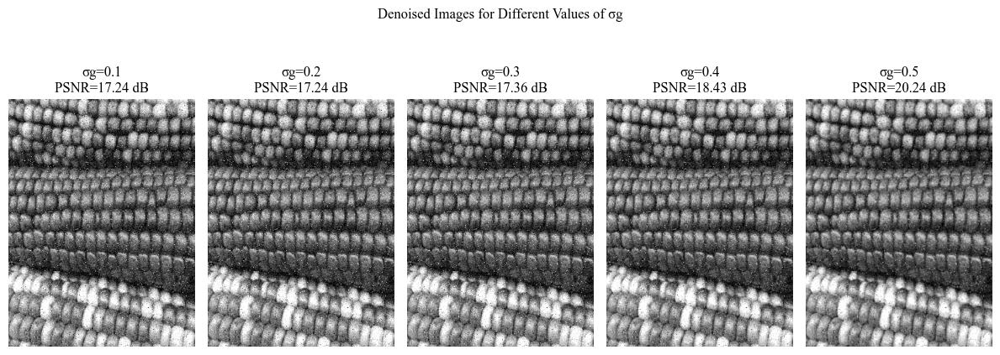

In [24]:
# %% 0.05, 0.01 - Gaussian
# for Image2
noisy_image2 = add_pepper_salt_noise(image2, 0.01)
noisy_image2 = add_gaussian_noise(noisy_image2, 0.05, 0.01)
cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/gaussian/0.05_0.01/image2_noisy_0.05_0.01.jpg", noisy_image2 * 255)

sigma_g_values = np.arange(0.1, 0.6, 0.1)
kernel_size = 77

psnr_values_gaussian_image2 = []
for sigma_g in sigma_g_values:
    denoised_image_gaussian = cv2.GaussianBlur(noisy_image2, (kernel_size, kernel_size), sigma_g)
    psnr_gaussian = peak_signal_noise_ratio(image2, denoised_image_gaussian)
    cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/gaussian/0.05_0.01/image2_noisy_denoised_sigmag{sigma_g:.1f}_psnr{psnr_gaussian:.2f}.jpg", denoised_image_gaussian * 255)
    psnr_values_gaussian_image2.append(("Gaussian", sigma_g, psnr_gaussian, denoised_image_gaussian))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σg Values")
plt.xlabel("σg")
plt.ylabel("PSNR (dB)")

psnr_gaussian_values = [psnr_gaussian for (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in psnr_values_gaussian_image2]
sigma_gaussian_values = [sigma_g for (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in psnr_values_gaussian_image2]
plt.plot(sigma_gaussian_values, psnr_gaussian_values, label="Gaussian")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/gaussian/0.05_0.01/image2_psnr.jpg", dpi=320)


plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σg", y=0.8)

for idx, (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in enumerate(psnr_values_gaussian_image2, start=1):
    plt.subplot(1, len(sigma_g_values), idx)
    plt.imshow(denoised_image_gaussian, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"σg={sigma_g:.1f}\nPSNR={psnr_gaussian:.2f} dB")
    plt.axis("off")

plt.tight_layout()
plt.show()

#### 0.5, 0.1 - Gaussian - IMG2

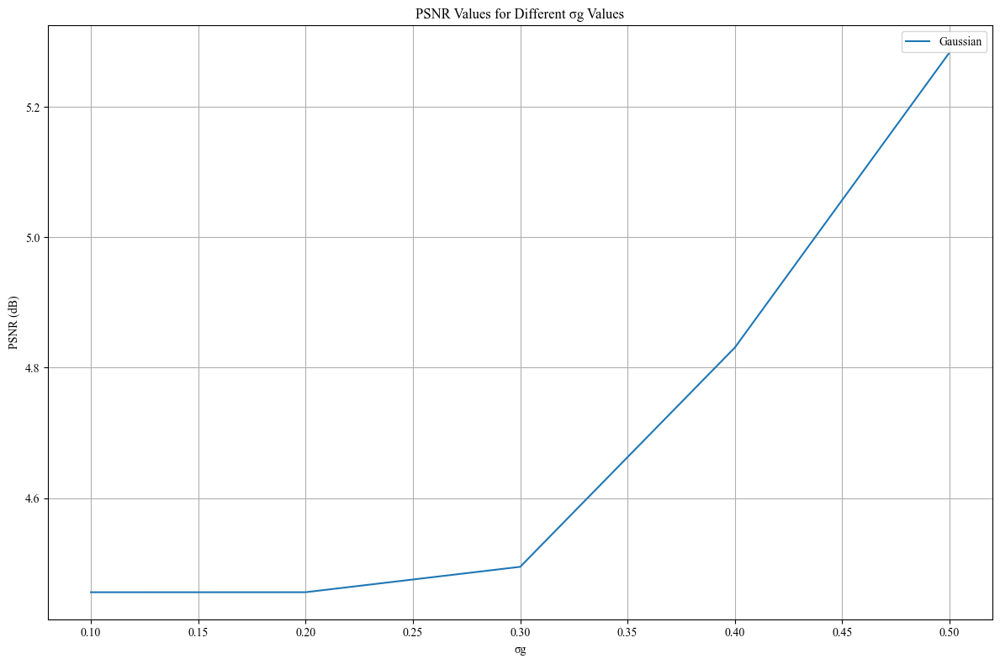

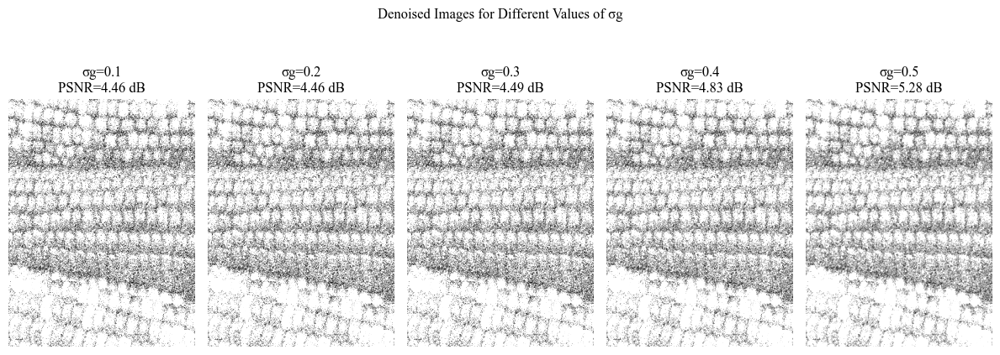

In [25]:
# %% 0.5, 0.1 - Gaussian
# for Image2
noisy_image2 = add_pepper_salt_noise(image2, 0.01)
noisy_image2 = add_gaussian_noise(noisy_image2, 0.5, 0.1)
cv2.imwrite("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/gaussian/0.5_0.1/image2_noisy_0.5_0.1.jpg", noisy_image2 * 255)

sigma_g_values = np.arange(0.1, 0.6, 0.1)
kernel_size = 77

psnr_values_gaussian_image2 = []
for sigma_g in sigma_g_values:
    denoised_image_gaussian = cv2.GaussianBlur(noisy_image2, (kernel_size, kernel_size), sigma_g)
    psnr_gaussian = peak_signal_noise_ratio(image2, denoised_image_gaussian)
    cv2.imwrite(f"C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/gaussian/0.5_0.1/image2_noisy_denoised_sigmag{sigma_g:.1f}_psnr{psnr_gaussian:.2f}.jpg", denoised_image_gaussian * 255)
    psnr_values_gaussian_image2.append(("Gaussian", sigma_g, psnr_gaussian, denoised_image_gaussian))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σg Values")
plt.xlabel("σg")
plt.ylabel("PSNR (dB)")

psnr_gaussian_values = [psnr_gaussian for (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in psnr_values_gaussian_image2]
sigma_gaussian_values = [sigma_g for (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in psnr_values_gaussian_image2]
plt.plot(sigma_gaussian_values, psnr_gaussian_values, label="Gaussian")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/gaussian/0.5_0.1/image2_psnr.jpg", dpi=320)


plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σg", y=0.8)

for idx, (_, sigma_g, psnr_gaussian, denoised_image_gaussian) in enumerate(psnr_values_gaussian_image2, start=1):
    plt.subplot(1, len(sigma_g_values), idx)
    plt.imshow(denoised_image_gaussian, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"σg={sigma_g:.1f}\nPSNR={psnr_gaussian:.2f} dB")
    plt.axis("off")

plt.tight_layout()
plt.show()


### Part b.2

#### 0.05, 0.01 - NLM & Gaussian - IMG1

C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\3264413296.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_nlm = peak_signal_noise_ratio(image1, denoised_image_nlm)


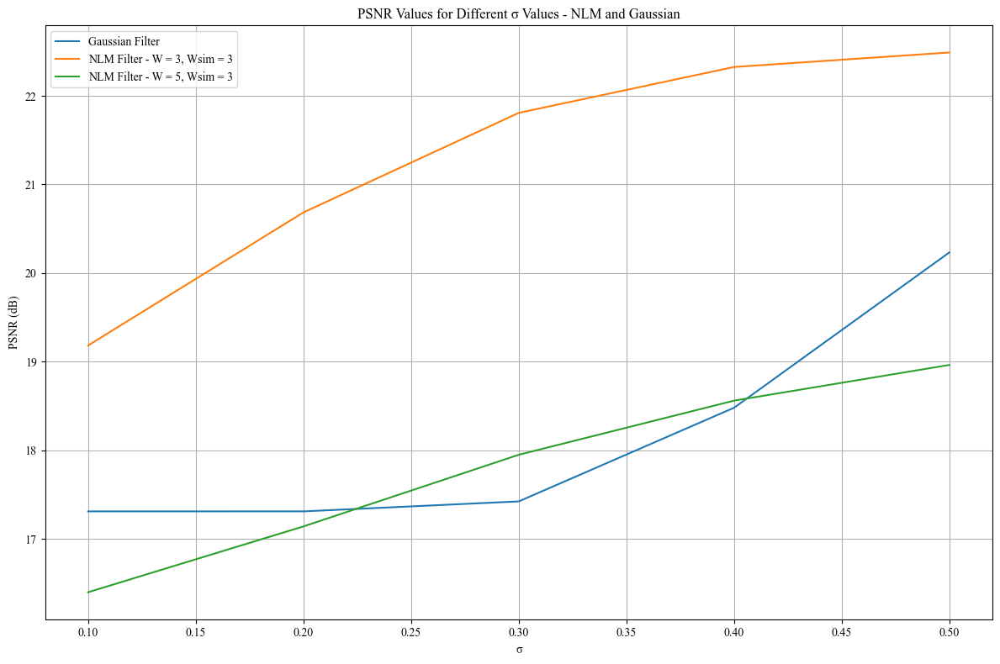

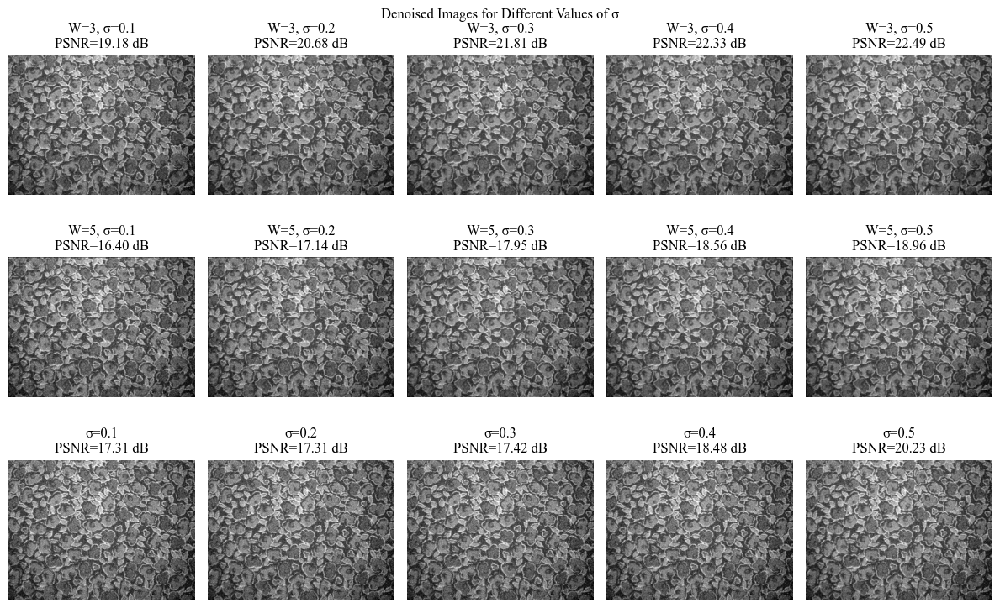

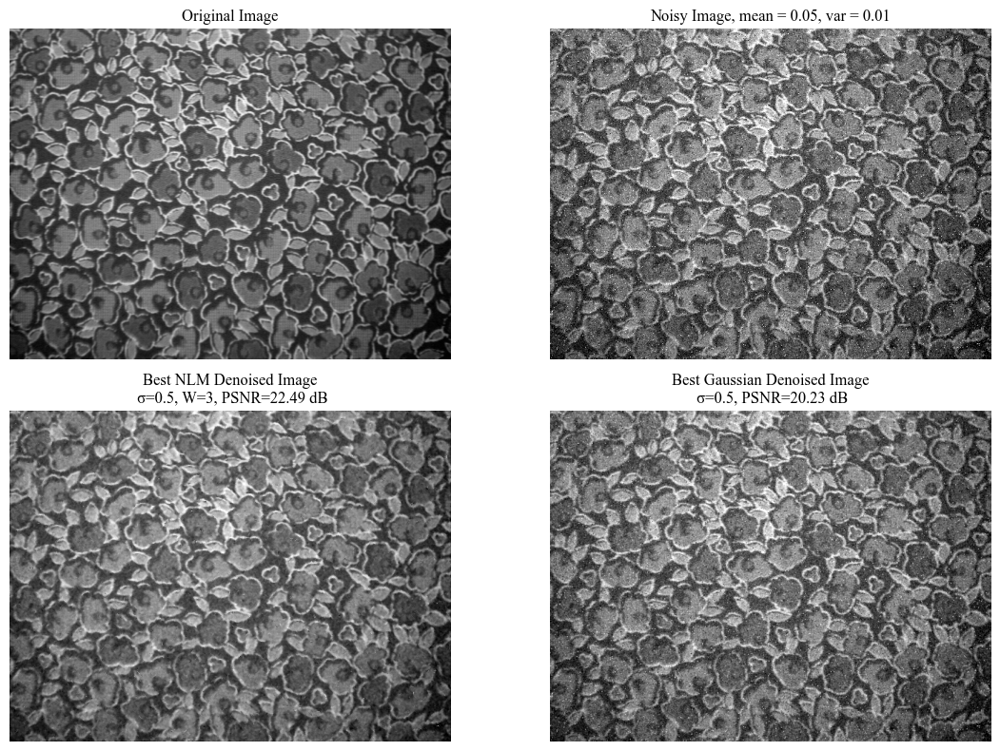

In [26]:
# %% part b.2
# %% 0.05, 0.01 - NLM & Gaussian
# for Image1
noisy_image1 = add_pepper_salt_noise(image1, 0.01)
noisy_image1 = add_gaussian_noise(noisy_image1, 0.05, 0.01)

W_values = [3, 5]
Wsim = 3
kernel_size = 77
sigma_values = np.arange(0.1, 0.6, 0.1)
psnr_values_image1 = []
for sigma in sigma_values:
    denoised_image_gaussian = cv2.GaussianBlur(noisy_image1, (kernel_size, kernel_size), sigma)
    psnr_gaussian = peak_signal_noise_ratio(image1, denoised_image_gaussian)
    for W in W_values:
        denoised_image_nlm = nlm_denoise(noisy_image1, sigma=sigma, W=W, Wsim=Wsim)
        psnr_nlm = peak_signal_noise_ratio(image1, denoised_image_nlm)
        psnr_values_image1.append((W, sigma, psnr_nlm, denoised_image_nlm))
    psnr_values_image1.append(("Gaussian", sigma, psnr_gaussian, denoised_image_gaussian))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σ Values - NLM and Gaussian")
plt.xlabel("σ")
plt.ylabel("PSNR (dB)")

psnr_Gaussian = [psnr for (x, sigma, psnr, denoised_images) in psnr_values_image1 if x == "Gaussian"]
plt.plot(sigma_values, psnr_Gaussian, label="Gaussian Filter")
for W in W_values:
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    plt.plot(sigma_values, psnr_W, label=f"NLM Filter - W = {W}, Wsim = {Wsim}")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/image1_psnr_NLM&Gaussian_0.05_0.01.jpg", dpi=320)

plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σ", y=0.95)

idx = 1
for W in W_values:
    denoised_images_nlm = [denoised_images for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    for indx, denoised_image in enumerate(denoised_images_nlm, start=0):
        plt.subplot(len(W_values) + 1, len(sigma_values), idx)
        plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
        plt.title(f"W={W}, σ={sigma_values[indx]:.1f}\nPSNR={psnr_W[indx]:.2f} dB")
        plt.axis("off")
        idx += 1

denoised_images_gaussian = [denoised_images for (x, sigma, psnr, denoised_images) in psnr_values_image1 if x == "Gaussian"]
idx = 1
for denoised_image in denoised_images_gaussian:
    plt.subplot(len(W_values) + 1, len(sigma_values), idx + (len(W_values) * len(sigma_values)))
    plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"σ={sigma_values[idx-1]:.1f}\nPSNR={psnr_Gaussian[idx-1]:.2f} dB")
    plt.axis("off")
    idx += 1

plt.tight_layout()
plt.show()

best_nlm_psnr = max([psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if (w != "Gaussian") and (np.isnan(psnr) == False)])
best_gaussian_psnr = max([psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == "Gaussian"])

best_nlm_idx = [idx for idx, (_, sigma, psnr, _) in enumerate(psnr_values_image1) if psnr == best_nlm_psnr]
best_gaussian_idx = [idx for idx, (_, sigma, psnr, _) in enumerate(psnr_values_image1) if psnr == best_gaussian_psnr]

best_nlm_image = psnr_values_image1[best_nlm_idx[0]][3]
best_gaussian_image = psnr_values_image1[best_gaussian_idx[0]][3]

plt.figure(figsize=(12, 8))
plt.subplot(2, 2, 1)
plt.title("Original Image")
plt.axis("off")
plt.imshow(image1, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 2)
plt.title("Noisy Image, mean = 0.05, var = 0.01")
plt.axis("off")
plt.imshow(noisy_image1, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 3)
plt.title(f"Best NLM Denoised Image\n σ={psnr_values_image1[best_nlm_idx[0]][1]}, W={psnr_values_image1[best_nlm_idx[0]][0]}, PSNR={best_nlm_psnr:.2f} dB")
plt.axis("off")
plt.imshow(best_nlm_image, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 4)
plt.title(f"Best Gaussian Denoised Image\n σ={psnr_values_image1[best_gaussian_idx[0]][1]}, PSNR={best_gaussian_psnr:.2f} dB")
plt.axis("off")
plt.imshow(best_gaussian_image, cmap=cm.gray, vmin=0, vmax=1)

plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/image1_BestDenoised_NLM&Gaussian_0.05_0.01.jpg", dpi=320)

#### 0.5, 0.1 - NLM & Gaussian - IMG1

C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\1732146304.py:16: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_nlm = peak_signal_noise_ratio(image1, denoised_image_nlm)
C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\930245244.py:62: RuntimeWarning: invalid value encountered in divide
  weights /= np.sum(weights)


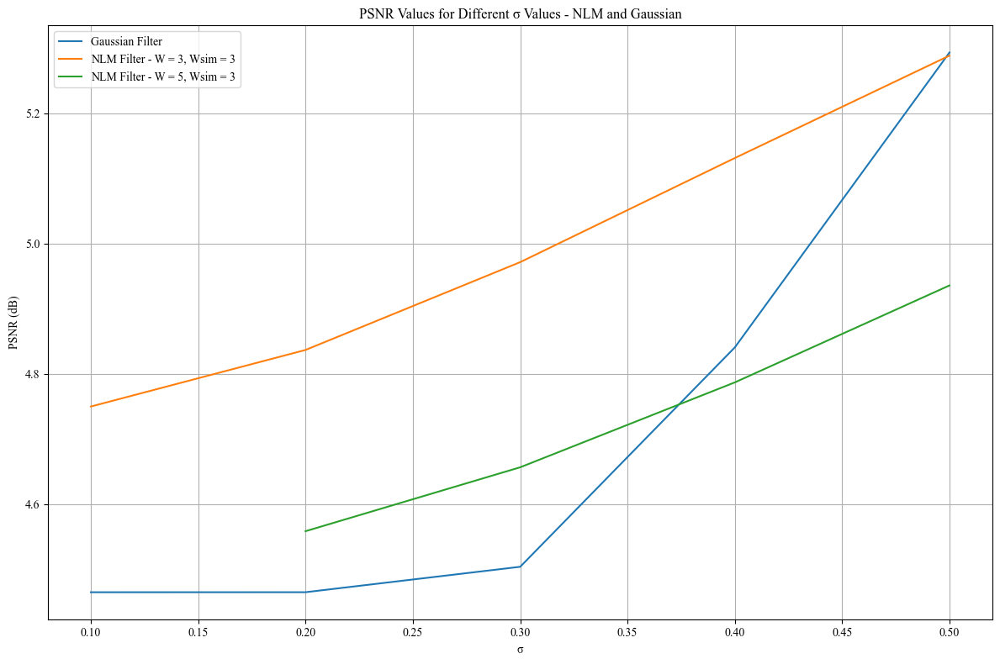

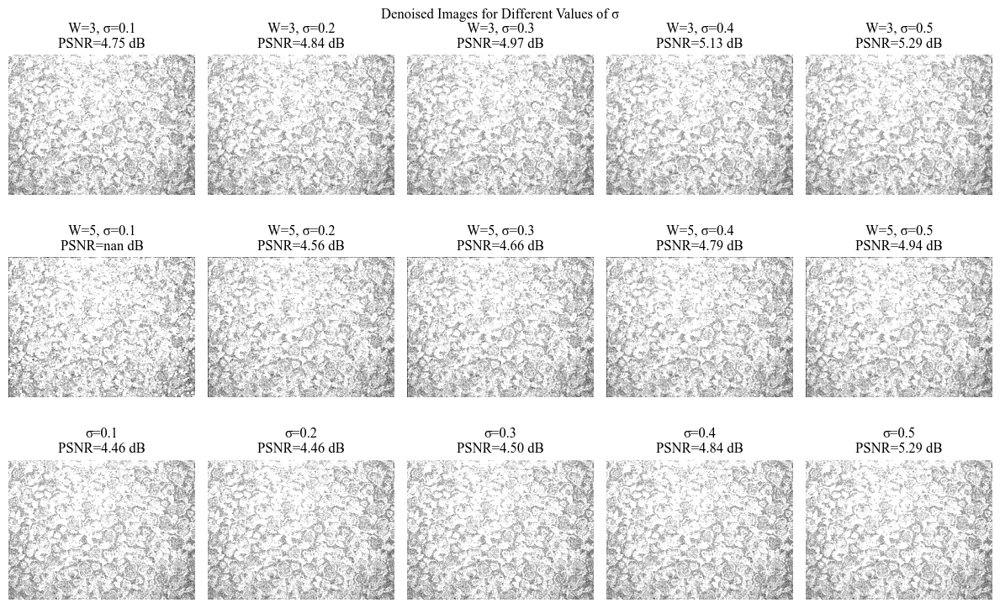

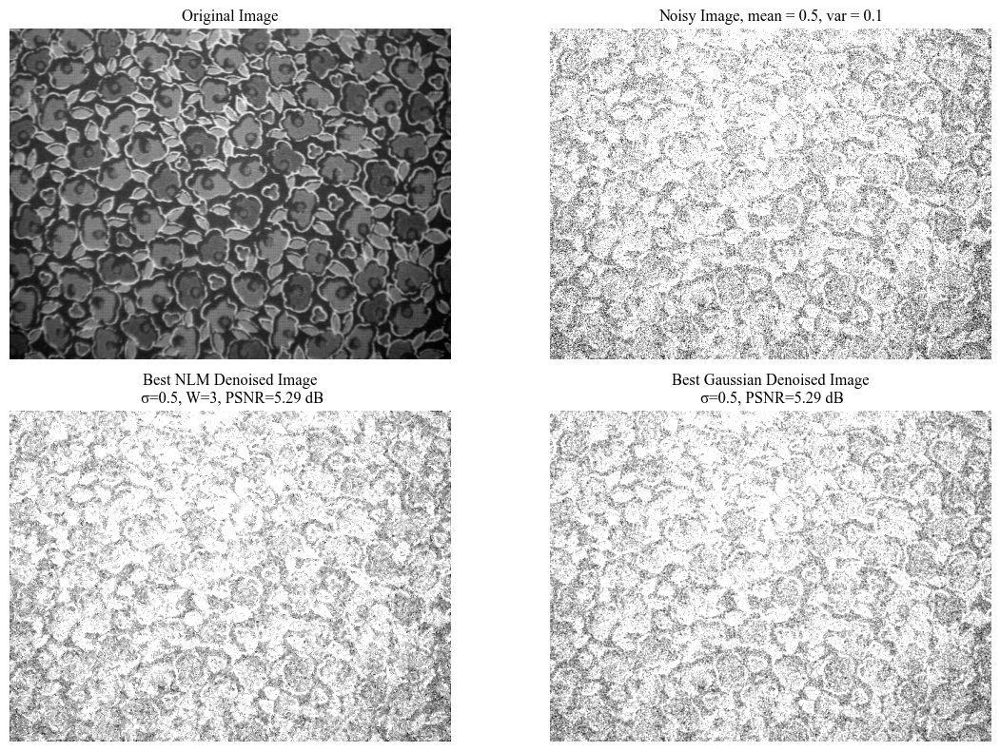

In [27]:
# %% 0.5, 0.1 - NLM & Gaussian
# for Image1
noisy_image1 = add_pepper_salt_noise(image1, 0.01)
noisy_image1 = add_gaussian_noise(noisy_image1, 0.5, 0.1)

W_values = [3, 5]
Wsim = 3
kernel_size = 77
sigma_values = np.arange(0.1, 0.6, 0.1)
psnr_values_image1 = []
for sigma in sigma_values:
    denoised_image_gaussian = cv2.GaussianBlur(noisy_image1, (kernel_size, kernel_size), sigma)
    psnr_gaussian = peak_signal_noise_ratio(image1, denoised_image_gaussian)
    for W in W_values:
        denoised_image_nlm = nlm_denoise(noisy_image1, sigma=sigma, W=W, Wsim=Wsim)
        psnr_nlm = peak_signal_noise_ratio(image1, denoised_image_nlm)
        psnr_values_image1.append((W, sigma, psnr_nlm, denoised_image_nlm))
    psnr_values_image1.append(("Gaussian", sigma, psnr_gaussian, denoised_image_gaussian))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σ Values - NLM and Gaussian")
plt.xlabel("σ")
plt.ylabel("PSNR (dB)")

psnr_Gaussian = [psnr for (x, sigma, psnr, denoised_images) in psnr_values_image1 if x == "Gaussian"]
plt.plot(sigma_values, psnr_Gaussian, label="Gaussian Filter")
for W in W_values:
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    plt.plot(sigma_values, psnr_W, label=f"NLM Filter - W = {W}, Wsim = {Wsim}")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/image1_psnr_NLM&Gaussian_0.5_0.1.jpg", dpi=320)

plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σ", y=0.95)

idx = 1
for W in W_values:
    denoised_images_nlm = [denoised_images for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == W]
    for indx, denoised_image in enumerate(denoised_images_nlm, start=0):
        plt.subplot(len(W_values) + 1, len(sigma_values), idx)
        plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
        plt.title(f"W={W}, σ={sigma_values[indx]:.1f}\nPSNR={psnr_W[indx]:.2f} dB")
        plt.axis("off")
        idx += 1

denoised_images_gaussian = [denoised_images for (x, sigma, psnr, denoised_images) in psnr_values_image1 if x == "Gaussian"]
idx = 1
for denoised_image in denoised_images_gaussian:
    plt.subplot(len(W_values) + 1, len(sigma_values), idx + (len(W_values) * len(sigma_values)))
    plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"σ={sigma_values[idx-1]:.1f}\nPSNR={psnr_Gaussian[idx-1]:.2f} dB")
    plt.axis("off")
    idx += 1

plt.tight_layout()
plt.show()

best_nlm_psnr = max([psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if (w != "Gaussian") and (np.isnan(psnr) == False)])
best_gaussian_psnr = max([psnr for (w, sigma, psnr, denoised_images) in psnr_values_image1 if w == "Gaussian"])

best_nlm_idx = [idx for idx, (_, sigma, psnr, _) in enumerate(psnr_values_image1) if psnr == best_nlm_psnr]
best_gaussian_idx = [idx for idx, (_, sigma, psnr, _) in enumerate(psnr_values_image1) if psnr == best_gaussian_psnr]

best_nlm_image = psnr_values_image1[best_nlm_idx[0]][3]
best_gaussian_image = psnr_values_image1[best_gaussian_idx[0]][3]

plt.figure(figsize=(12, 8))
plt.subplot(2, 2, 1)
plt.title("Original Image")
plt.axis("off")
plt.imshow(image1, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 2)
plt.title("Noisy Image, mean = 0.5, var = 0.1")
plt.axis("off")
plt.imshow(noisy_image1, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 3)
plt.title(f"Best NLM Denoised Image\n σ={psnr_values_image1[best_nlm_idx[0]][1]}, W={psnr_values_image1[best_nlm_idx[0]][0]}, PSNR={best_nlm_psnr:.2f} dB")
plt.axis("off")
plt.imshow(best_nlm_image, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 4)
plt.title(f"Best Gaussian Denoised Image\n σ={psnr_values_image1[best_gaussian_idx[0]][1]}, PSNR={best_gaussian_psnr:.2f} dB")
plt.axis("off")
plt.imshow(best_gaussian_image, cmap=cm.gray, vmin=0, vmax=1)

plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image1/image1_BestDenoised_NLM&Gaussian_0.5_0.1.jpg", dpi=320)


#### 0.05, 0.01 - NLM & Gaussian - IMG2

C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\791849506.py:16: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_nlm = peak_signal_noise_ratio(image2, denoised_image_nlm)


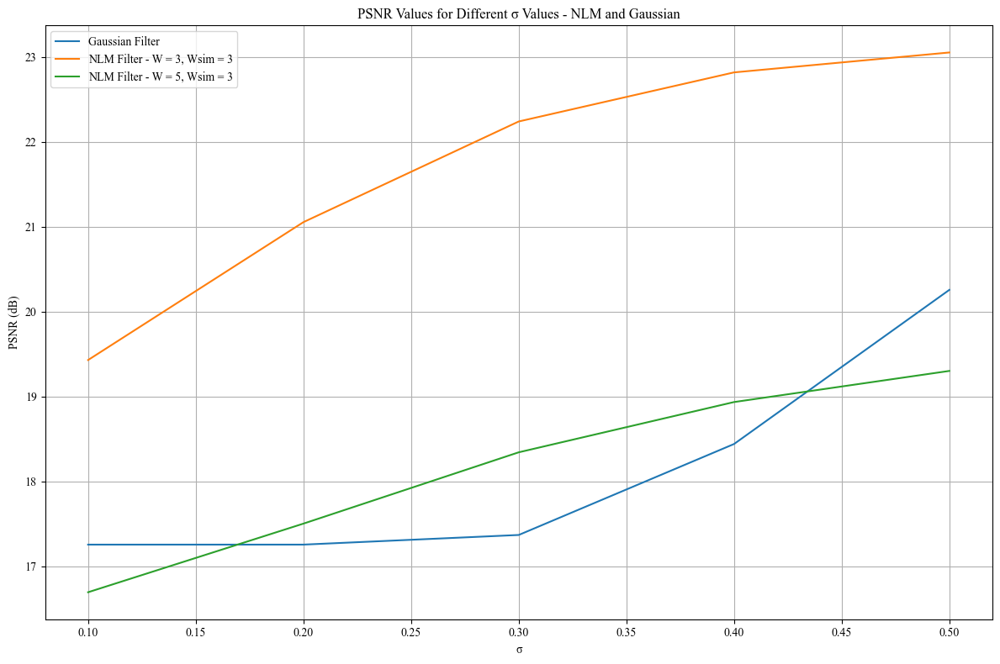

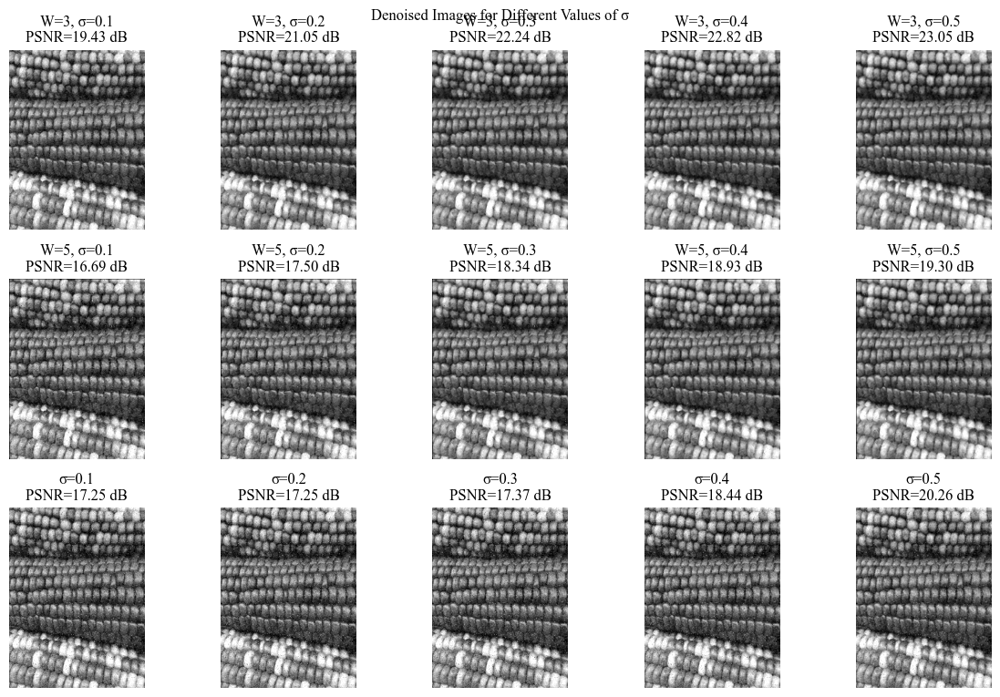

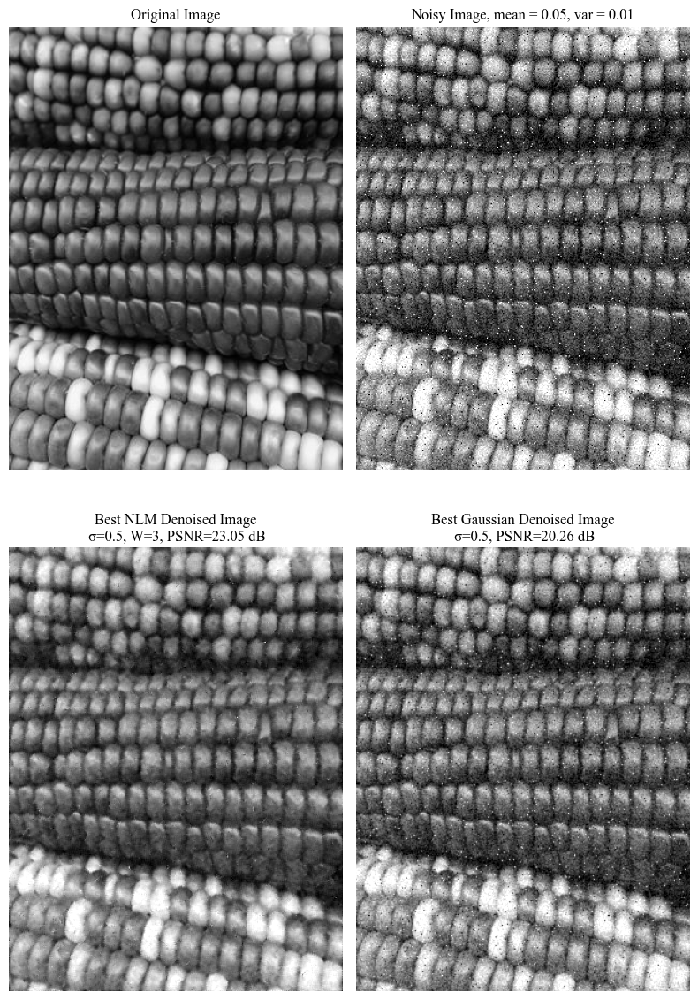

In [28]:
# %% 0.05, 0.01 - NLM & Gaussian
# for Image2
noisy_image2 = add_pepper_salt_noise(image2, 0.01)
noisy_image2 = add_gaussian_noise(noisy_image2, 0.05, 0.01)

W_values = [3, 5]
Wsim = 3
kernel_size = 77
sigma_values = np.arange(0.1, 0.6, 0.1)
psnr_values_image2 = []
for sigma in sigma_values:
    denoised_image_gaussian = cv2.GaussianBlur(noisy_image2, (kernel_size, kernel_size), sigma)
    psnr_gaussian = peak_signal_noise_ratio(image2, denoised_image_gaussian)
    for W in W_values:
        denoised_image_nlm = nlm_denoise(noisy_image2, sigma=sigma, W=W, Wsim=Wsim)
        psnr_nlm = peak_signal_noise_ratio(image2, denoised_image_nlm)
        psnr_values_image2.append((W, sigma, psnr_nlm, denoised_image_nlm))
    psnr_values_image2.append(("Gaussian", sigma, psnr_gaussian, denoised_image_gaussian))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σ Values - NLM and Gaussian")
plt.xlabel("σ")
plt.ylabel("PSNR (dB)")

psnr_Gaussian = [psnr for (x, sigma, psnr, denoised_images) in psnr_values_image2 if x == "Gaussian"]
plt.plot(sigma_values, psnr_Gaussian, label="Gaussian Filter")
for W in W_values:
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    plt.plot(sigma_values, psnr_W, label=f"NLM Filter - W = {W}, Wsim = {Wsim}")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/image2_psnr_NLM&Gaussian_0.05_0.01.jpg", dpi=320)

plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σ", y=0.95)

idx = 1
for W in W_values:
    denoised_images_nlm = [denoised_images for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    for indx, denoised_image in enumerate(denoised_images_nlm, start=0):
        plt.subplot(len(W_values) + 1, len(sigma_values), idx)
        plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
        plt.title(f"W={W}, σ={sigma_values[indx]:.1f}\nPSNR={psnr_W[indx]:.2f} dB")
        plt.axis("off")
        idx += 1

denoised_images_gaussian = [denoised_images for (x, sigma, psnr, denoised_images) in psnr_values_image2 if x == "Gaussian"]
idx = 1
for denoised_image in denoised_images_gaussian:
    plt.subplot(len(W_values) + 1, len(sigma_values), idx + (len(W_values) * len(sigma_values)))
    plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"σ={sigma_values[idx-1]:.1f}\nPSNR={psnr_Gaussian[idx-1]:.2f} dB")
    plt.axis("off")
    idx += 1

plt.tight_layout()
plt.show()

best_nlm_psnr = max([psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if (w != "Gaussian") and (np.isnan(psnr) == False)])
best_gaussian_psnr = max([psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == "Gaussian"])

best_nlm_idx = [idx for idx, (_, sigma, psnr, _) in enumerate(psnr_values_image2) if psnr == best_nlm_psnr]
best_gaussian_idx = [idx for idx, (_, sigma, psnr, _) in enumerate(psnr_values_image2) if psnr == best_gaussian_psnr]

best_nlm_image = psnr_values_image2[best_nlm_idx[0]][3]
best_gaussian_image = psnr_values_image2[best_gaussian_idx[0]][3]

plt.figure(figsize=(8, 12))
plt.subplot(2, 2, 1)
plt.title("Original Image")
plt.axis("off")
plt.imshow(image2, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 2)
plt.title("Noisy Image, mean = 0.05, var = 0.01")
plt.axis("off")
plt.imshow(noisy_image2, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 3)
plt.title(f"Best NLM Denoised Image\n σ={psnr_values_image2[best_nlm_idx[0]][1]}, W={psnr_values_image2[best_nlm_idx[0]][0]}, PSNR={best_nlm_psnr:.2f} dB")
plt.axis("off")
plt.imshow(best_nlm_image, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 4)
plt.title(f"Best Gaussian Denoised Image\n σ={psnr_values_image2[best_gaussian_idx[0]][1]}, PSNR={best_gaussian_psnr:.2f} dB")
plt.axis("off")
plt.imshow(best_gaussian_image, cmap=cm.gray, vmin=0, vmax=1)

plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/image2_BestDenoised_NLM&Gaussian_0.05_0.01.jpg", dpi=320)


#### 0.5, 0.1 - NLM & Gaussian - IMG2

C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\3592360604.py:16: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psnr_nlm = peak_signal_noise_ratio(image2, denoised_image_nlm)
C:\Users\aryak\AppData\Local\Temp\ipykernel_18784\930245244.py:62: RuntimeWarning: invalid value encountered in divide
  weights /= np.sum(weights)


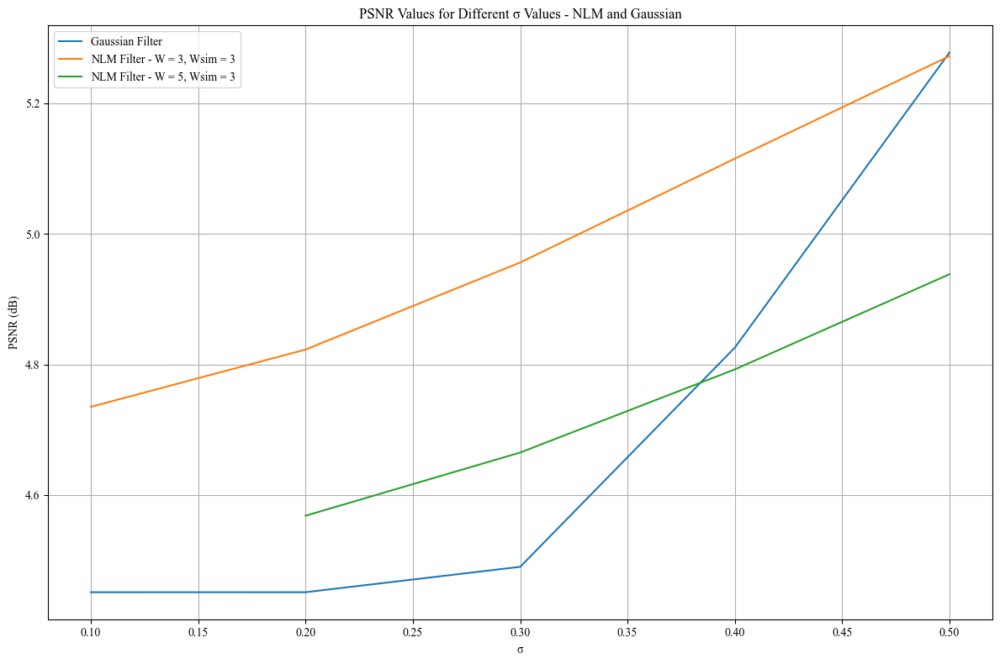

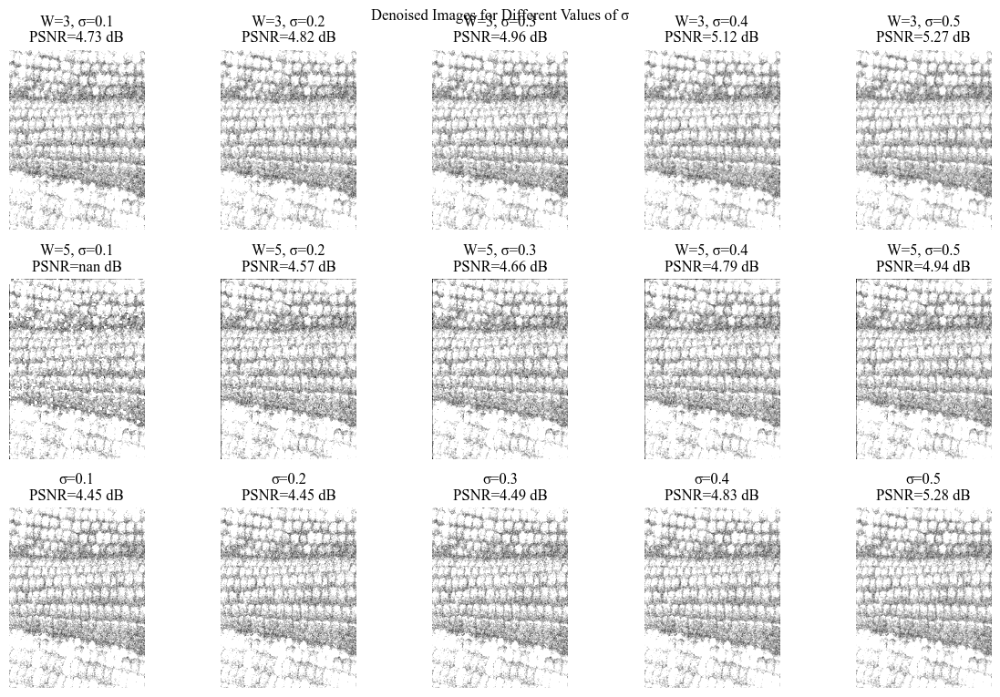

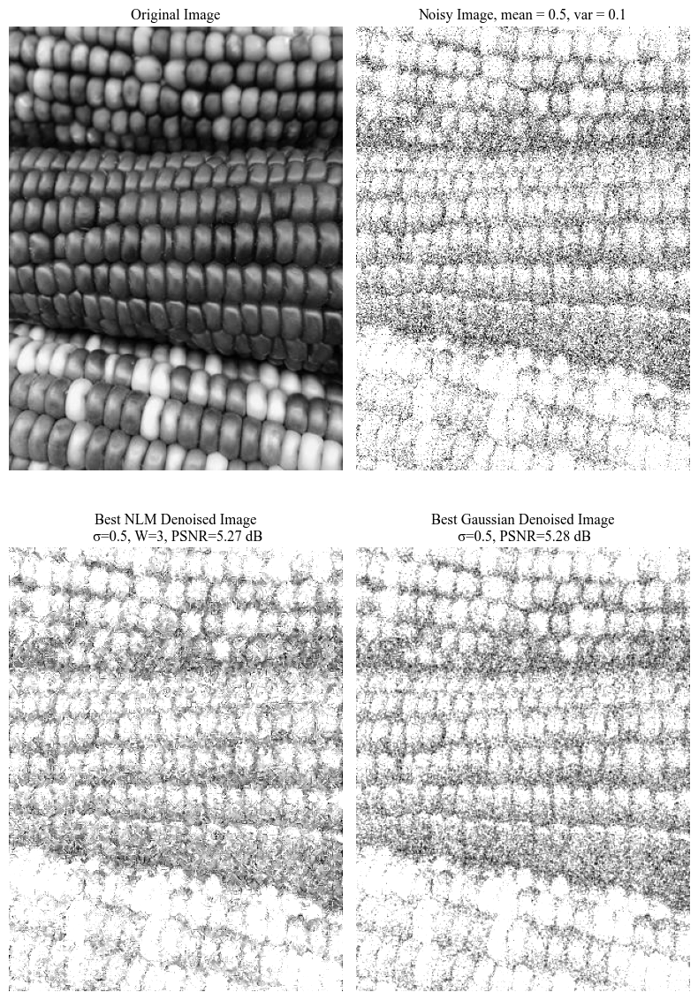

In [29]:
# %% 0.5, 0.1 - NLM & Gaussian
# for Image2
noisy_image2 = add_pepper_salt_noise(image2, 0.01)
noisy_image2 = add_gaussian_noise(noisy_image2, 0.5, 0.1)

W_values = [3, 5]
Wsim = 3
kernel_size = 77
sigma_values = np.arange(0.1, 0.6, 0.1)
psnr_values_image2 = []
for sigma in sigma_values:
    denoised_image_gaussian = cv2.GaussianBlur(noisy_image2, (kernel_size, kernel_size), sigma)
    psnr_gaussian = peak_signal_noise_ratio(image2, denoised_image_gaussian)
    for W in W_values:
        denoised_image_nlm = nlm_denoise(noisy_image2, sigma=sigma, W=W, Wsim=Wsim)
        psnr_nlm = peak_signal_noise_ratio(image2, denoised_image_nlm)
        psnr_values_image2.append((W, sigma, psnr_nlm, denoised_image_nlm))
    psnr_values_image2.append(("Gaussian", sigma, psnr_gaussian, denoised_image_gaussian))

plt.figure(figsize=(12, 8))
plt.title("PSNR Values for Different σ Values - NLM and Gaussian")
plt.xlabel("σ")
plt.ylabel("PSNR (dB)")

psnr_Gaussian = [psnr for (x, sigma, psnr, denoised_images) in psnr_values_image2 if x == "Gaussian"]
plt.plot(sigma_values, psnr_Gaussian, label="Gaussian Filter")
for W in W_values:
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    plt.plot(sigma_values, psnr_W, label=f"NLM Filter - W = {W}, Wsim = {Wsim}")

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/image2_psnr_NLM&Gaussian_0.5_0.1.jpg", dpi=320)

plt.figure(figsize=(12, 8))
plt.suptitle("Denoised Images for Different Values of σ", y=0.95)

idx = 1
for W in W_values:
    denoised_images_nlm = [denoised_images for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    psnr_W = [psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == W]
    for indx, denoised_image in enumerate(denoised_images_nlm, start=0):
        plt.subplot(len(W_values) + 1, len(sigma_values), idx)
        plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
        plt.title(f"W={W}, σ={sigma_values[indx]:.1f}\nPSNR={psnr_W[indx]:.2f} dB")
        plt.axis("off")
        idx += 1

denoised_images_gaussian = [denoised_images for (x, sigma, psnr, denoised_images) in psnr_values_image2 if x == "Gaussian"]
idx = 1
for denoised_image in denoised_images_gaussian:
    plt.subplot(len(W_values) + 1, len(sigma_values), idx + (len(W_values) * len(sigma_values)))
    plt.imshow(denoised_image, cmap=cm.gray, vmin=0, vmax=1)
    plt.title(f"σ={sigma_values[idx-1]:.1f}\nPSNR={psnr_Gaussian[idx-1]:.2f} dB")
    plt.axis("off")
    idx += 1

plt.tight_layout()
plt.show()

best_nlm_psnr = max([psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if (w != "Gaussian") and (np.isnan(psnr) == False)])
best_gaussian_psnr = max([psnr for (w, sigma, psnr, denoised_images) in psnr_values_image2 if w == "Gaussian"])

best_nlm_idx = [idx for idx, (_, sigma, psnr, _) in enumerate(psnr_values_image2) if psnr == best_nlm_psnr]
best_gaussian_idx = [idx for idx, (_, sigma, psnr, _) in enumerate(psnr_values_image2) if psnr == best_gaussian_psnr]

best_nlm_image = psnr_values_image2[best_nlm_idx[0]][3]
best_gaussian_image = psnr_values_image2[best_gaussian_idx[0]][3]

plt.figure(figsize=(8, 12))
plt.subplot(2, 2, 1)
plt.title("Original Image")
plt.axis("off")
plt.imshow(image2, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 2)
plt.title("Noisy Image, mean = 0.5, var = 0.1")
plt.axis("off")
plt.imshow(noisy_image2, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 3)
plt.title(f"Best NLM Denoised Image\n σ={psnr_values_image2[best_nlm_idx[0]][1]}, W={psnr_values_image2[best_nlm_idx[0]][0]}, PSNR={best_nlm_psnr:.2f} dB")
plt.axis("off")
plt.imshow(best_nlm_image, cmap=cm.gray, vmin=0, vmax=1)

plt.subplot(2, 2, 4)
plt.title(f"Best Gaussian Denoised Image\n σ={psnr_values_image2[best_gaussian_idx[0]][1]}, PSNR={best_gaussian_psnr:.2f} dB")
plt.axis("off")
plt.imshow(best_gaussian_image, cmap=cm.gray, vmin=0, vmax=1)

plt.tight_layout()
plt.show()
#plt.savefig("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/3/image2/image2_BestDenoised_NLM&Gaussian_0.5_0.1.jpg", dpi=320)  # %%

In the denoised images, a noticeable increase in PSNR was observed, which was anticipated. The process was conducted in two stages, with each image being divided into two parts and processed separately. Initially, Gaussian noise with a mean of 0.5 and a variance of 0.1 was added, followed by a second iteration with a mean of 0.05 and a variance of 0.01. Filtering operations were then applied using both the NLM and Gaussian filters.

For the NLM filter, varying the parameter W from 3 to 5 resulted in a decrease in PSNR, aligning with expectations. This decrease is attributed to the expansion of the neighborhood search window, which leads to a reduction in denoising accuracy. Notably, for both images, the optimal NLM filter configuration was found to be with parameters W=3, Wsim=3, and sigma=0.5, as evidenced by the improved results.

---

## Question 4
### Part a

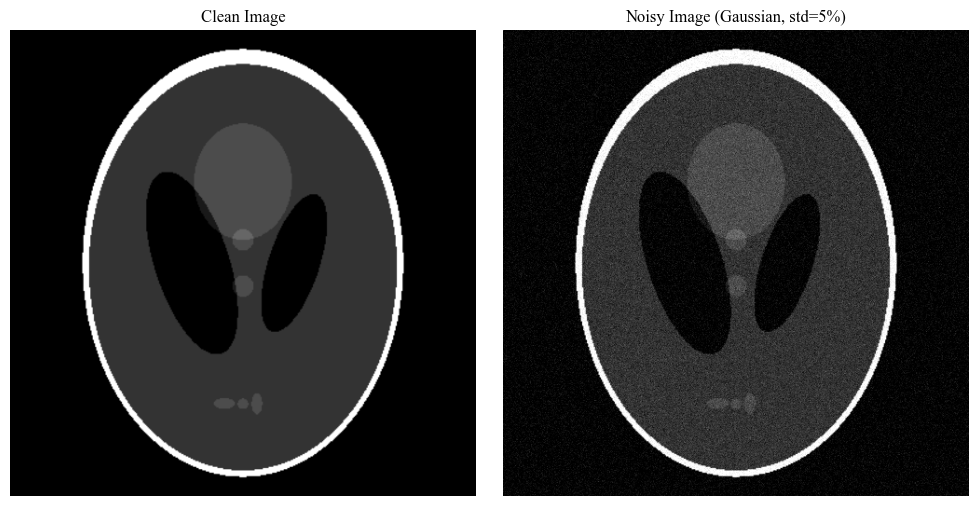

In [30]:
# %% Question 4
# %% part a
N = 500
std = 0.05

phantom = shepp_logan_phantom()
phantom = resize(phantom, (N, N), anti_aliasing=True)
noisy_phantom = random_noise(phantom, mode="gaussian", var=std**2)

fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(phantom, cmap="gray", vmin=0, vmax=1)
axes[0].set_title("Clean Image")
axes[0].axis("off")
axes[1].imshow(noisy_phantom, cmap="gray", vmin=0, vmax=1)
axes[1].set_title("Noisy Image (Gaussian, std=5%)")
axes[1].axis("off")
plt.tight_layout()
plt.show()

### Part b and c

SNR criterion for the filter: 17.10 dB


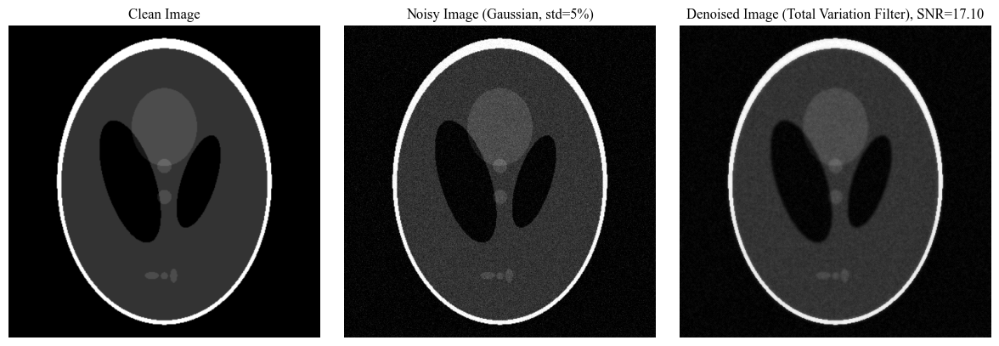

In [31]:
# %% part b and c
lambda_ = 10
iterations = 100
dt = 0.01


def tv_filter(image, lambda_, iterations, dt):
    u = image.copy()
    N = u.shape[0]
    epsilon = 1e-10
    for _ in range(iterations):
        grad_x_plus = np.roll(u, -1, axis=1) - u
        grad_x_minus = u - np.roll(u, 1, axis=1)
        grad_y_plus = np.roll(u, -1, axis=0) - u
        grad_y_minus = u - np.roll(u, 1, axis=0)

        m_x = (np.sign(grad_x_plus) + np.sign(grad_x_minus)) / 2 * np.minimum(np.abs(grad_x_plus), np.abs(grad_x_minus))
        m_y = (np.sign(grad_y_plus) + np.sign(grad_y_minus)) / 2 * np.minimum(np.abs(grad_y_plus), np.abs(grad_y_minus))

        grad_x = (grad_x_plus / (np.sqrt(grad_x_plus**2 + m_y**2) + epsilon)) - (grad_x_minus / (np.sqrt(grad_x_minus**2 + m_y**2) + epsilon))
        grad_y = (grad_y_plus / (np.sqrt(grad_y_plus**2 + m_x**2) + epsilon)) - (grad_y_minus / (np.sqrt(grad_y_minus**2 + m_x**2) + epsilon))

        u += dt * (grad_x + grad_y) + dt * lambda_ * (image - u)

        u[0, :] = u[1, :]
        u[N - 1, :] = u[N - 2, :]
        u[:, 0] = u[:, 1]
        u[:, N - 1] = u[:, N - 2]

    return u


def calculate_snr(original_image, noisy_image, denoised_image):
    signal = np.sum(original_image**2)
    noise = np.sum((original_image - noisy_image) ** 2)
    residual = np.sum((original_image - denoised_image) ** 2)
    snr = 10 * np.log10((signal + noise) / residual)
    return snr


filtered_image = tv_filter(noisy_phantom, lambda_, iterations, dt)


snr = calculate_snr(phantom, noisy_phantom, filtered_image)
print(f"SNR criterion for the filter: {snr:.2f} dB")


fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(phantom, cmap="gray", vmin=0, vmax=1)
axes[0].set_title("Clean Image")
axes[0].axis("off")
axes[1].imshow(noisy_phantom, cmap="gray", vmin=0, vmax=1)
axes[1].set_title("Noisy Image (Gaussian, std=5%)")
axes[1].axis("off")
axes[2].imshow(filtered_image, cmap="gray", vmin=0, vmax=1)
axes[2].set_title(f"Denoised Image (Total Variation Filter), SNR={snr:.2f}")
axes[2].axis("off")
plt.tight_layout()
plt.show()

---
## Question 5

### TV_Chambolle


Chambolle itr 0: Obj 316.4405910651594, rel dgap=0.9842449849329026
Chambolle itr 1: Obj 314.6002817367089, rel dgap=0.9892615637290428
Chambolle itr 2: Obj 260.60614836476816, rel dgap=0.9932875471119106
Chambolle itr 3: Obj 209.0842247488963, rel dgap=0.9953109416200857
Chambolle itr 4: Obj 171.04176954364357, rel dgap=0.9964292094019553
Chambolle itr 5: Obj 146.32454746797066, rel dgap=0.9970583477279862
Chambolle itr 6: Obj 131.97423958448326, rel dgap=0.9973978533711843
Chambolle itr 7: Obj 124.76043703895357, rel dgap=0.9975628858832506
Chambolle itr 8: Obj 121.97597144983138, rel dgap=0.9976264210081226
Chambolle itr 9: Obj 121.62430613840934, rel dgap=0.9976358392768803
Chambolle itr 10: Obj 122.37363203169207, rel dgap=0.9976210327862539
Chambolle itr 11: Obj 123.42655614618252, rel dgap=0.9975995259249798
Chambolle itr 12: Obj 124.37373130015567, rel dgap=0.9975802520527335
Chambolle itr 13: Obj 125.06067969211927, rel dgap=0.99756657908627
Chambolle itr 14: Obj 125.480710531

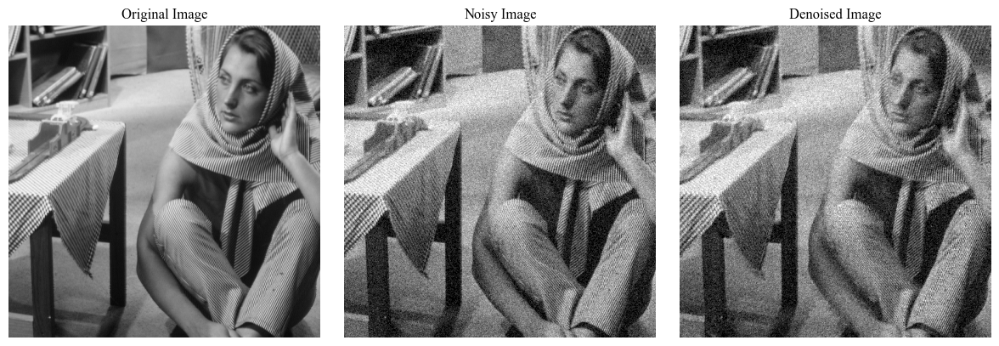

In [32]:
# %% Question 5
# %% TV_Chambolle


def TV_Chambolle(w1, w2, f, lbd, alpha, NIT, GapTol, verbose):
    n = f.shape[0]
    g = lbd * f
    gx = np.concatenate([g[:, 1:n] - g[:, 0: n - 1], np.zeros((n, 1))], axis=1)
    gy = np.concatenate([g[1:n, :] - g[0: n - 1, :], np.zeros((1, n))], axis=0)
    sf = 0.5 * lbd * np.sum(f**2)
    Energy = np.zeros(NIT + 1)
    Dgap = np.zeros(NIT + 1)
    TimeCost = np.zeros(NIT + 1)

    DivW = np.concatenate((w1[:, :1], w1[:, 1:] - w1[:, :-1]), axis=1) + np.concatenate((w2[:1, :], w2[1:, :] - w2[:-1, :]), axis=0)
    Energy[0] = 0.5 * np.sum((DivW - g) ** 2)
    u = f - (1 / lbd) * DivW
    ux = np.concatenate([u[:, 1:n] - u[:, 0: n - 1], np.zeros((n, 1))], axis=1)
    uy = np.concatenate([u[1:n, :] - u[0: n - 1, :], np.zeros((1, n))], axis=0)
    gu_norm = np.sqrt(ux**2 + uy**2)
    Dgap[0] = np.sum(gu_norm + ux * w1 + uy * w2)
    TimeCost[0] = 0
    t0 = 0 

    for itr in range(NIT):
        dFx = np.concatenate((DivW[:, :1] - DivW[:, 1:], np.zeros((n, 1))), axis=1) + gx
        dFy = np.concatenate((DivW[:1, :] - DivW[1:, :], np.zeros((1, n))), axis=0) + gy

        w1_new = w1 - alpha * dFx
        w2_new = w2 - alpha * dFy
        dFnorm = alpha * np.sqrt(dFx**2 + dFy**2)
        w1 = w1_new / (1.0 + dFnorm)
        w2 = w2_new / (1.0 + dFnorm)

        DivW = np.concatenate((w1[:, :1], w1[:, 1:] - w1[:, :-1]), axis=1) + np.concatenate((w2[:1, :], w2[1:, :] - w2[:-1, :]), axis=0)
        Energy_new = 0.5 * np.sum((DivW - g) ** 2)
        Energy[itr + 1] = Energy_new

        u = f - (1 / lbd) * DivW
        ux = np.concatenate([u[:, 1:n] - u[:, 0: n - 1], np.zeros((n, 1))], axis=1)
        uy = np.concatenate([u[1:n, :] - u[0: n - 1, :], np.zeros((1, n))], axis=0)
        gu_norm = np.sqrt(ux**2 + uy**2)
        Dgap[itr + 1] = np.sum(gu_norm + ux * w1 + uy * w2)

        TimeCost[itr + 1] = 0

        if itr == 0:
            t0 = time.process_time()

        if verbose:
            print(f"Chambolle itr {itr}: Obj {sf - Energy_new / lbd}, rel dgap={Dgap[itr+1] / (np.abs(sf - Energy_new / lbd) + np.abs(Dgap[itr+1]))}")

        if Dgap[itr + 1] < GapTol:
            if verbose:
                print(f"Chambolle: convergence tolerance reached: {Dgap[itr+1]}")
            break

    return u, w1, w2, Energy, Dgap, TimeCost, itr


image = cv2.imread("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/TV/TV.png", cv2.IMREAD_GRAYSCALE)
image = cv2.normalize(image, None, 0, 1, cv2.NORM_MINMAX, dtype=cv2.CV_32F)  # normalized image

noisy_image = random_noise(image, mode="gaussian", var=0.01)

w1 = np.zeros_like(noisy_image)
w2 = np.zeros_like(noisy_image)

lbd = 0.2
alpha = 0.2
NIT = 100
GapTol = 1e-6
verbose = True

denoised_image, _, _, _, _, _, _ = TV_Chambolle(w1, w2, noisy_image, lbd, alpha, NIT, GapTol, verbose)

plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(image, cmap="gray", vmin=0, vmax=1)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(noisy_image, cmap="gray", vmin=0, vmax=1)
plt.title("Noisy Image")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(denoised_image, cmap="gray", vmin=0, vmax=1)
plt.title("Denoised Image")
plt.axis("off")

plt.tight_layout()
plt.show()

### TV_GPCL

GPCL iter 0: Obj=112.08839887748263, rel dgap=0.996326823635422
GPCL iter 1: Obj=157.86202031545326, rel dgap=0.9916804240264876
GPCL iter 2: Obj=170.73239497949908, rel dgap=0.9910399251488762
GPCL iter 3: Obj=167.4973821956337, rel dgap=0.9931190379571124
GPCL iter 4: Obj=156.82762589163895, rel dgap=0.9947686274462355
GPCL iter 5: Obj=143.27367185248886, rel dgap=0.9958841740906029
GPCL iter 6: Obj=129.2257226828374, rel dgap=0.9966636984911567
GPCL iter 7: Obj=115.90764855844054, rel dgap=0.9972310669861036
GPCL iter 8: Obj=103.89970589020231, rel dgap=0.9976563490560011
GPCL iter 9: Obj=93.42295945256319, rel dgap=0.9979813350310743
GPCL iter 10: Obj=84.49883047010644, rel dgap=0.9982325445692624
GPCL iter 11: Obj=77.04088436031316, rel dgap=0.9984278797936744
GPCL iter 12: Obj=70.90861556965046, rel dgap=0.9985800395217093
GPCL iter 13: Obj=65.93926185476175, rel dgap=0.9986984160776956
GPCL iter 14: Obj=61.966568751850446, rel dgap=0.9987901794321207
GPCL iter 15: Obj=58.8316225

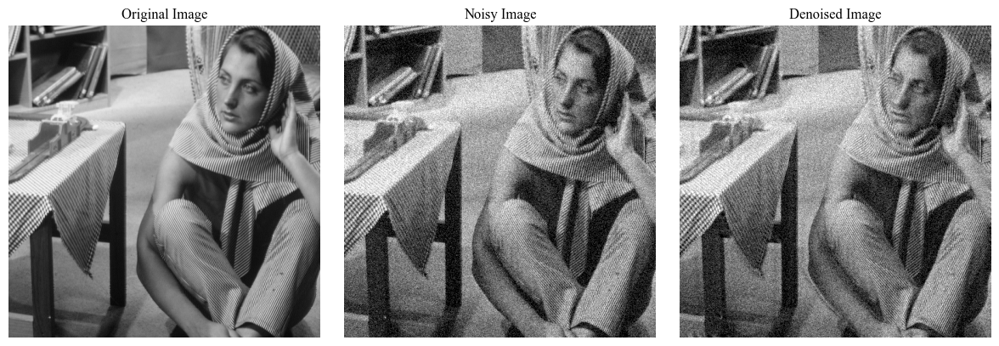

In [33]:
# %% TV_GPCL


def TV_GPCL(w1, w2, f, lbd, alpha, NIT, GapTol, verbose):
    n = f.shape[0]
    g = lbd * f
    gx = np.concatenate([g[:, 1:n] - g[:, 0: n - 1], np.zeros((n, 1))], axis=1)
    gy = np.concatenate([g[1:n, :] - g[0: n - 1, :], np.zeros((1, n))], axis=0)
    sf = 0.5 * lbd * np.sum(f**2)
    Energy = np.zeros(NIT + 1)
    Dgap = np.zeros(NIT + 1)
    TimeCost = np.zeros(NIT + 1)

    DivW = np.concatenate((w1[:, :1], w1[:, 1:] - w1[:, :-1]), axis=1) + np.concatenate((w2[:1, :], w2[1:, :] - w2[:-1, :]), axis=0)
    Energy[0] = 0.5 * np.sum((DivW - g) ** 2)
    u = f - (1 / lbd) * DivW
    ux = np.concatenate([u[:, 1:n] - u[:, 0: n - 1], np.zeros((n, 1))], axis=1)
    uy = np.concatenate([u[1:n, :] - u[0: n - 1, :], np.zeros((1, n))], axis=0)
    gu_norm = np.sqrt(ux**2 + uy**2)
    Dgap[0] = np.sum(gu_norm + ux * w1 + uy * w2)
    TimeCost[0] = 0
    t0 = 0

    for itr in range(NIT):
        dFx = np.concatenate((DivW[:, :1] - DivW[:, 1:], np.zeros((n, 1))), axis=1) + gx
        dFy = np.concatenate((DivW[:1, :] - DivW[1:, :], np.zeros((1, n))), axis=0) + gy

        w1 = w1 - alpha * dFx
        w2 = w2 - alpha * dFy
        wnorm = np.maximum(1, np.sqrt(w1**2 + w2**2))
        w1 = w1 / wnorm
        w2 = w2 / wnorm

        DivW = np.concatenate((w1[:, :1], w1[:, 1:] - w1[:, :-1]), axis=1) + np.concatenate((w2[:1, :], w2[1:, :] - w2[:-1, :]), axis=0)
        Energy_new = 0.5 * np.sum((DivW - g) ** 2)
        Energy[itr + 1] = Energy_new

        u = f - (1 / lbd) * DivW
        ux = np.concatenate([u[:, 1:n] - u[:, 0: n - 1], np.zeros((n, 1))], axis=1)
        uy = np.concatenate([u[1:n, :] - u[0: n - 1, :], np.zeros((1, n))], axis=0)
        gu_norm = np.sqrt(ux**2 + uy**2)
        Dgap[itr + 1] = np.sum(gu_norm + ux * w1 + uy * w2)

        TimeCost[itr + 1] = 0

        if itr == 0:
            t0 = time.process_time()

        if verbose:
            print(f"GPCL iter {itr}: Obj={sf - Energy_new / lbd}, rel dgap={Dgap[itr+1] / (np.abs(sf - Energy_new / lbd) + np.abs(Dgap[itr+1]))}")

        if Dgap[itr + 1] < GapTol:
            if verbose:
                print(f"GPCL convergence tolerance reached: {Dgap[itr+1]}")
            break

    return u, w1, w2, Energy, Dgap, TimeCost, itr


image = cv2.imread("C:/Users/aryak/OneDrive/Desktop/MAM/HW02_MIAP_Corrected/HW02_MIAP_Corrected/TV/TV.png", cv2.IMREAD_GRAYSCALE)
image = cv2.normalize(image, None, 0, 1, cv2.NORM_MINMAX, dtype=cv2.CV_32F)  # normalized image

noisy_image = random_noise(image, mode="gaussian", var=0.01)

w1 = np.zeros_like(noisy_image)
w2 = np.zeros_like(noisy_image)

lbd = 0.1
alpha = 0.1
NIT = 100
GapTol = 1e-6
verbose = True

denoised_image, _, _, _, _, _, _ = TV_GPCL(w1, w2, noisy_image, lbd, alpha, NIT, GapTol, verbose)

plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.imshow(image, cmap="gray", vmin=0, vmax=1)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(noisy_image, cmap="gray", vmin=0, vmax=1)
plt.title("Noisy Image")
plt.axis("off")


plt.subplot(1, 3, 3)
plt.imshow(denoised_image, cmap="gray", vmin=0, vmax=1)
plt.title("Denoised Image")
plt.axis("off")

plt.tight_layout()
plt.show()

To implement the provided codes for TV (Total Variation) denoising, we need to follow these steps:

1. **Load the Image**: Load the image we want to denoise. The code assumes that the image is in grayscale format and is normalized to the range [0, 1].

2. **Add Noise**: Add noise to the image. The code adds Gaussian noise with a specified variance to the image.

3. **Initialize Variables**: Initialize the dual variables `w1` and `w2` as arrays of zeros, with the same shape as the noisy image.

4. **Set Parameters**: Set the parameters for the TV denoising algorithm, including the regularization parameter `lbd`, the step size `alpha`, the number of iterations `NIT`, and the convergence tolerance `GapTol`.

5. **Denoise the Image**: Call the TV denoising function (`TV_Chambolle` or `TV_GPCL`) with the noisy image, dual variables, and parameters. The function returns the denoised image, updated dual variables, and other information such as energy, duality gap, and iteration count.

6. **Display the Results**: Display the original image, noisy image, and denoised image using Matplotlib.

Here's a brief analysis of the TV denoising results based on the provided code:

- **TV_Chambolle**: This function implements the Chambolle TV denoising method. It computes the TV-denoised image using gradient descent with a fixed step size. The algorithm iteratively updates the dual variables `w1` and `w2` and computes the denoised image `u` using the divergence of the dual variables.

- **TV_GPCL**: This function implements the Gradient Projection for Convex L1 (GPCL) TV denoising method. It uses a different update strategy for the dual variables `w1` and `w2`, where the dual variables are normalized after each update. This normalization ensures that the dual variables stay within a feasible region.

Both methods aim to minimize the total variation of the image, which leads to smoother and less noisy images. The choice between these methods may depend on the specific characteristics of the noise and the desired trade-off between computational complexity and denoising performance.